In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats
from scipy.stats import zscore
#from sklearn.preprocessing import StandardScaler
import tensorflow as tf
from sklearn.model_selection import train_test_split
import itertools
import os
from datetime import datetime
#from phik.report import plot_correlation_matrix
#from patsy import dmatrices
#from statsmodels.stats.outliers_influence import variance_inflation_factor
#from featurewiz import featurewiz
#from optbinning import BinningProcess
from sklearn.metrics import classification_report
# import openpyxl
#from pycaret.classification import *
# import re
# from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.metrics import accuracy_score, balanced_accuracy_score, mean_squared_error, mean_absolute_percentage_error, mean_absolute_error, r2_score
# from sklearn.tree import DecisionTreeClassifier, plot_tree
# from sklearn.metrics import confusion_matrix, f1_score, roc_auc_score, precision_score, recall_score, roc_curve, auc
import pickle
# import jenkspy
# from openpyxl.drawing.image import Image
# from openpyxl import load_workbook
# from imblearn.over_sampling import SMOTE
# from collections import Counter
from keras.models import load_model

c:\Users\Alessandro\AppData\Local\Programs\Python\Python310\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
c:\Users\Alessandro\AppData\Local\Programs\Python\Python310\lib\site-packages\numpy\.libs\libopenblas.FB5AE2TYXYH2IJRDKGDGQ3XBKLKTF43H.gfortran-win_amd64.dll
c:\Users\Alessandro\AppData\Local\Programs\Python\Python310\lib\site-packages\numpy\.libs\libopenblas64__v0.3.21-gcc_10_3_0.dll
c:\Users\Alessandro\AppData\Local\Programs\Python\Python310\lib\site-packages\numpy\.libs\libopenblas64__v0.3.23-246-g3d31191b-gcc_10_3_0.dll
  warnings.warn("loaded more than 1 DLL from .libs:"


In [2]:
pd.set_option('display.max_columns', None)
#pd.set_option('display.max_rows', None)
pd.options.display.float_format = '{:,.2f}'.format
sns.set()

In [3]:
file_path = "Dataset Bitcoin+ esteso da me (passato_1500, futuro_30, periodo originale dal 28-4-2013 al 4-3-2024).csv"
df = pd.read_csv(file_path)

In [4]:
df_bitcoin = df.copy()

In [5]:
df_bitcoin

prezzo_presente  prezzo_passato_1  prezzo_passato_2  prezzo_passato_3  \
0            2,520.81          2,412.54          2,573.41          2,418.64   
1            2,517.89          2,520.81          2,412.54          2,573.41   
2            2,623.63          2,517.89          2,520.81          2,412.54   
3            2,689.05          2,623.63          2,517.89          2,520.81   
4            2,413.90          2,689.05          2,623.63          2,517.89   
...               ...               ...               ...               ...   
2427        39,930.08         38,759.18         38,771.40         38,535.13   
2428        39,555.51         39,930.08         38,759.18         38,771.40   
2429        39,390.46         39,555.51         39,930.08         38,759.18   
2430        39,601.99         39,390.46         39,555.51         39,930.08   
2431        39,978.19         39,601.99         39,390.46         39,555.51   

      prezzo_passato_4  prezzo_passato_5  prezzo_passato_6  prezzo_passato_7  \
0             2,266.55          2,271.28          2,228.14          2,173.67   
1             2,418.64          2,266.55          2,271.28          2,228.14   
2             2,573.41          2,418.64          2,266.55          2,271.28   
3             2,412.54          2,573.41          2,418.64          2,266.55   
4             2,520.81          2,412.54          2,573.41          2,418.64   
...                ...               ...               ...               ...   
2427         36,811.16         36,871.21         36,689.36         36,313.42   
2428         38,535.13         36,811.16         36,871.21         36,689.36   
2429         38,771.40         38,535.13         36,811.16         36,871.21   
2430         38,759.18         38,771.40         38,535.13         36,811.16   
2431         39,930.08         38,759.18         38,771.40         38,535.13   

      prezzo_passato_8  prezzo_passato_9  prezzo_passato_10  \
0             2,072.35          1,940.00           2,052.41   
1             2,173.67          2,072.35           1,940.00   
2             2,228.14          2,173.67           2,072.35   
3             2,271.28          2,228.14           2,173.67   
4             2,266.55          2,271.28           2,228.14   
...                ...               ...                ...   
2427         38,141.45         38,173.22          38,150.14   
2428         36,313.42         38,141.45          38,173.22   
2429         36,689.36         36,313.42          38,141.45   
2430         36,871.21         36,689.36          36,313.42   
2431         36,811.16         36,871.21          36,689.36   

      prezzo_passato_11  prezzo_passato_12  prezzo_passato_13  \
0              1,984.97           1,861.84           2,023.12   
1              2,052.41           1,984.97           1,861.84   
2              1,940.00           2,052.41           1,984.97   
3              2,072.35           1,940.00           2,052.41   
4              2,173.67           2,072.35           1,940.00   
...                 ...                ...                ...   
2427          37,938.78          39,242.29          39,668.76   
2428          38,150.14          37,938.78          39,242.29   
2429          38,173.22          38,150.14          37,938.78   
2430          38,141.45          38,173.22          38,150.14   
2431          36,313.42          38,141.45          38,173.22   

      prezzo_passato_14  prezzo_passato_15  prezzo_passato_16  \
0              2,126.74           2,182.38           2,049.32   
1              2,023.12           2,126.74           2,182.38   
2              1,861.84           2,023.12           2,126.74   
3              1,984.97           1,861.84           2,023.12   
4              2,052.41           1,984.97           1,861.84   
...                 ...                ...                ...   
2427          38,908.90          38,190.21          39,081.07   
2428          39,668.76          38,90

In [6]:
df_bitcoin.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2432 entries, 0 to 2431
Columns: 1534 entries, prezzo_presente to Anno
dtypes: float64(1531), int64(3)
memory usage: 28.5 MB


In [7]:
df_bitcoin.shape

(2432, 1534)

In [8]:
df_bitcoin.isna().sum().sum()

0

<h6> Scelgo quale porzione del dataset tenere </h6>

In [9]:
df_bitcoin = df_bitcoin.iloc[:, :-3]
df_bitcoin

prezzo_presente  prezzo_passato_1  prezzo_passato_2  prezzo_passato_3  \
0            2,520.81          2,412.54          2,573.41          2,418.64   
1            2,517.89          2,520.81          2,412.54          2,573.41   
2            2,623.63          2,517.89          2,520.81          2,412.54   
3            2,689.05          2,623.63          2,517.89          2,520.81   
4            2,413.90          2,689.05          2,623.63          2,517.89   
...               ...               ...               ...               ...   
2427        39,930.08         38,759.18         38,771.40         38,535.13   
2428        39,555.51         39,930.08         38,759.18         38,771.40   
2429        39,390.46         39,555.51         39,930.08         38,759.18   
2430        39,601.99         39,390.46         39,555.51         39,930.08   
2431        39,978.19         39,601.99         39,390.46         39,555.51   

      prezzo_passato_4  prezzo_passato_5  prezzo_passato_6  prezzo_passato_7  \
0             2,266.55          2,271.28          2,228.14          2,173.67   
1             2,418.64          2,266.55          2,271.28          2,228.14   
2             2,573.41          2,418.64          2,266.55          2,271.28   
3             2,412.54          2,573.41          2,418.64          2,266.55   
4             2,520.81          2,412.54          2,573.41          2,418.64   
...                ...               ...               ...               ...   
2427         36,811.16         36,871.21         36,689.36         36,313.42   
2428         38,535.13         36,811.16         36,871.21         36,689.36   
2429         38,771.40         38,535.13         36,811.16         36,871.21   
2430         38,759.18         38,771.40         38,535.13         36,811.16   
2431         39,930.08         38,759.18         38,771.40         38,535.13   

      prezzo_passato_8  prezzo_passato_9  prezzo_passato_10  \
0             2,072.35          1,940.00           2,052.41   
1             2,173.67          2,072.35           1,940.00   
2             2,228.14          2,173.67           2,072.35   
3             2,271.28          2,228.14           2,173.67   
4             2,266.55          2,271.28           2,228.14   
...                ...               ...                ...   
2427         38,141.45         38,173.22          38,150.14   
2428         36,313.42         38,141.45          38,173.22   
2429         36,689.36         36,313.42          38,141.45   
2430         36,871.21         36,689.36          36,313.42   
2431         36,811.16         36,871.21          36,689.36   

      prezzo_passato_11  prezzo_passato_12  prezzo_passato_13  \
0              1,984.97           1,861.84           2,023.12   
1              2,052.41           1,984.97           1,861.84   
2              1,940.00           2,052.41           1,984.97   
3              2,072.35           1,940.00           2,052.41   
4              2,173.67           2,072.35           1,940.00   
...                 ...                ...                ...   
2427          37,938.78          39,242.29          39,668.76   
2428          38,150.14          37,938.78          39,242.29   
2429          38,173.22          38,150.14          37,938.78   
2430          38,141.45          38,173.22          38,150.14   
2431          36,313.42          38,141.45          38,173.22   

      prezzo_passato_14  prezzo_passato_15  prezzo_passato_16  \
0              2,126.74           2,182.38           2,049.32   
1              2,023.12           2,126.74           2,182.38   
2              1,861.84           2,023.12           2,126.74   
3              1,984.97           1,861.84           2,023.12   
4              2,052.41           1,984.97           1,861.84   
...                 ...                ...                ...   
2427          38,908.90          38,190.21          39,081.07   
2428          39,668.76          38,90

In [10]:
# Definiamo una funzione per spostare le colonne all'inizio del dataset
def move_column_inplace(df, col, pos):
    col = df.pop(col)
    df.insert(pos, col.name, col)

In [11]:
df_bitcoin

prezzo_presente  prezzo_passato_1  prezzo_passato_2  prezzo_passato_3  \
0            2,520.81          2,412.54          2,573.41          2,418.64   
1            2,517.89          2,520.81          2,412.54          2,573.41   
2            2,623.63          2,517.89          2,520.81          2,412.54   
3            2,689.05          2,623.63          2,517.89          2,520.81   
4            2,413.90          2,689.05          2,623.63          2,517.89   
...               ...               ...               ...               ...   
2427        39,930.08         38,759.18         38,771.40         38,535.13   
2428        39,555.51         39,930.08         38,759.18         38,771.40   
2429        39,390.46         39,555.51         39,930.08         38,759.18   
2430        39,601.99         39,390.46         39,555.51         39,930.08   
2431        39,978.19         39,601.99         39,390.46         39,555.51   

      prezzo_passato_4  prezzo_passato_5  prezzo_passato_6  prezzo_passato_7  \
0             2,266.55          2,271.28          2,228.14          2,173.67   
1             2,418.64          2,266.55          2,271.28          2,228.14   
2             2,573.41          2,418.64          2,266.55          2,271.28   
3             2,412.54          2,573.41          2,418.64          2,266.55   
4             2,520.81          2,412.54          2,573.41          2,418.64   
...                ...               ...               ...               ...   
2427         36,811.16         36,871.21         36,689.36         36,313.42   
2428         38,535.13         36,811.16         36,871.21         36,689.36   
2429         38,771.40         38,535.13         36,811.16         36,871.21   
2430         38,759.18         38,771.40         38,535.13         36,811.16   
2431         39,930.08         38,759.18         38,771.40         38,535.13   

      prezzo_passato_8  prezzo_passato_9  prezzo_passato_10  \
0             2,072.35          1,940.00           2,052.41   
1             2,173.67          2,072.35           1,940.00   
2             2,228.14          2,173.67           2,072.35   
3             2,271.28          2,228.14           2,173.67   
4             2,266.55          2,271.28           2,228.14   
...                ...               ...                ...   
2427         38,141.45         38,173.22          38,150.14   
2428         36,313.42         38,141.45          38,173.22   
2429         36,689.36         36,313.42          38,141.45   
2430         36,871.21         36,689.36          36,313.42   
2431         36,811.16         36,871.21          36,689.36   

      prezzo_passato_11  prezzo_passato_12  prezzo_passato_13  \
0              1,984.97           1,861.84           2,023.12   
1              2,052.41           1,984.97           1,861.84   
2              1,940.00           2,052.41           1,984.97   
3              2,072.35           1,940.00           2,052.41   
4              2,173.67           2,072.35           1,940.00   
...                 ...                ...                ...   
2427          37,938.78          39,242.29          39,668.76   
2428          38,150.14          37,938.78          39,242.29   
2429          38,173.22          38,150.14          37,938.78   
2430          38,141.45          38,173.22          38,150.14   
2431          36,313.42          38,141.45          38,173.22   

      prezzo_passato_14  prezzo_passato_15  prezzo_passato_16  \
0              2,126.74           2,182.38           2,049.32   
1              2,023.12           2,126.74           2,182.38   
2              1,861.84           2,023.12           2,126.74   
3              1,984.97           1,861.84           2,023.12   
4              2,052.41           1,984.97           1,861.84   
...                 ...                ...                ...   
2427          38,908.90          38,190.21          39,081.07   
2428          39,668.76          38,90

In [12]:
df_bitcoin.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2432 entries, 0 to 2431
Columns: 1531 entries, prezzo_presente to prezzo_futuro_30
dtypes: float64(1531)
memory usage: 28.4 MB


### Descrizioni statistiche

In [13]:
def describex(data):
    data = pd.DataFrame(data)
    stats = data.describe(percentiles=[0.01,0.25,0.5,0.75,0.90,0.95,0.99])
    skewness = data.skew()
    kurtosis = data.kurtosis()
    skewness_df = pd.DataFrame({'skewness' : skewness}).T
    kurtosis_df = pd.DataFrame({'kurtosis' : kurtosis}).T
    mediane = data.median()
    mediane_df = pd.DataFrame({'mediane' : mediane}).T
    valori_missing = pd.DataFrame({'valori missing': data.isna().sum()}).T
    percentuale_missing = ((data.isna().sum() / len(data) * 100).round(2)).apply(lambda x: f'{x}%')
    percentuale_missing_df = pd.DataFrame({'percentuale missing': percentuale_missing}).T
    valori_unici = pd.DataFrame({'valori_unici':data.nunique()}).T
    return pd.concat([stats, kurtosis_df, skewness_df, mediane_df, valori_missing, percentuale_missing_df, valori_unici])

In [14]:
describex(df_bitcoin)

prezzo_presente prezzo_passato_1 prezzo_passato_2  \
count                      2,432.00         2,432.00         2,432.00   
mean                      18,387.86        18,372.41        18,357.18   
std                       14,061.85        14,058.76        14,055.81   
min                        1,680.10         1,680.10         1,680.10   
1%                         2,264.60         2,264.60         2,264.60   
25%                        6,616.01         6,612.25         6,610.16   
50%                       12,276.23        12,149.02        12,078.33   
75%                       27,695.53        27,686.68        27,682.57   
90%                       39,862.26        39,823.01        39,823.01   
95%                       44,778.39        44,778.39        44,778.39   
99%                       53,178.59        53,178.59        53,178.59   
max                       58,358.42        58,358.42        58,358.42   
kurtosis                      -0.58            -0.58            -0.57   
skewness                       0.76             0.76             0.76   
mediane                   12,276.23        12,149.02        12,078.33   
valori missing                    0                0                0   
percentuale missing            0.0%             0.0%             0.0%   
valori_unici                   2432             2432             2432   

                    prezzo_passato_3 prezzo_passato_4 prezzo_passato_5  \
count                       2,432.00         2,432.00         2,432.00   
mean                       18,341.98        18,326.65        18,311.16   
std                        14,053.04        14,050.23        14,047.16   
min                         1,680.10         1,680.10         1,680.10   
1%                          2,264.60         2,264.52         2,264.52   
25%                         6,604.39         6,600.57         6,596.34   
50%                        12,032.14        11,958.92        11,889.22   
75%                        27,671.03        27,665.47        27,644.11   
90%                        39,823.01        39,823.01        39,681.71   
95%                        44,778.39        44,778.39        44,778.39   
99%                        53,178.59        53,178.59        53,178.59   
max                        58,358.42        58,358.42        58,358.42   
kurtosis                       -0.57            -0.57            -0.56   
skewness                        0.76             0.76             0.77   
mediane                    12,032.14        11,958.92        11,889.22   
valori missing                     0                0                0   
percentuale missing             0.0%             0.0%             0.0%   
valori_unici                    2432             2432             2432   

                    prezzo_passato_6 prezzo_passato_7 prezzo_passato_8  \
count                       2,432.00         2,432.00         2,432.00   
mean                       18,296.14        18,281.09        18,266.10   
std                        14,044.82        14,042.48        14,040.31   
min                         1,680.10         1,680.10         1,680.10   
1%                          2,253.26         2,247.83         2,241.60   
25%                         6,589.26         6,586.93         6,583.55   
50%                        11,873.67        11,834.37        11,793.25   
75%                        27,630.98        27,623.40        27,596.50   
90%                        39,681.71        39,681.71        39,681.71   
95%                        44,778.39        44,778.39        44,778.39   
99%                        53,178.59        53,178.59        53,178.59   
max                        58,358.42        58,358.42        58,358.42   
kurtosis                       -0.56            -0.56            -0.55   
skewness                        0.77             0.77             0.77   
mediane                    11,873.67        11,834.37        11,793.25   
valori missing                     0     

In [15]:
# correlation_matrix = df_bitcoin.corr()

# plt.figure(figsize=(15, 20))
# sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
# plt.title('Matrice di Correlazione')
# plt.show()

In [16]:
# Analisi grafica 
def func_analisi_grafica(df, numeric_var):
    ''' Definisco la funzione per distribution plot, boxplot e Q-Q plot delle variabili numeriche '''
    plt.figure(figsize=(16,8))
    
    # Distribution plot
    plt.subplot(1,3,1)
    sns.histplot(data=df, x=df[numeric_var], element="step", stat="density")
    plt.title("Distribution plot of "+numeric_var)
       
    # Box plot
    plt.subplot(1,3,2)
    sns.boxplot(x=df[numeric_var], data=df)
    plt.title("Box plot of "+numeric_var)
    
    # Box plot
    plt.subplot(1,3,3)
    df[numeric_var].fillna(0, inplace = True)
    stats.probplot(df[numeric_var], dist="norm", plot=plt)
    plt.title("Q-Q plot of "+numeric_var)
    
    plt.show()

<h5> Analisi grafica </h5>

In [17]:
# for variable in numerical_vars:
#     func_analisi_grafica(df_bitcoin, variable)
#     print("*"*110)

<h5> Riempio eventuali colonne con valori missing </h5>

In [18]:
df_bitcoin.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2432 entries, 0 to 2431
Columns: 1531 entries, prezzo_presente to prezzo_futuro_30
dtypes: float64(1531)
memory usage: 28.4 MB


In [19]:
# conto quanti nan ci sono in ogni colonna
df_bitcoin.isna().sum()

prezzo_presente     0
prezzo_passato_1    0
prezzo_passato_2    0
prezzo_passato_3    0
prezzo_passato_4    0
                   ..
prezzo_futuro_26    0
prezzo_futuro_27    0
prezzo_futuro_28    0
prezzo_futuro_29    0
prezzo_futuro_30    0
Length: 1531, dtype: int64

In [20]:
# conto quanti nan ci sono in totale
df_bitcoin.isna().sum().sum()

0

In [21]:
def riempi_nan_con_media_e_missing(df):
    # Creo una copia del DataFrame originale perchè altrimenti mi modifica anche il dataframe originale mi pare
    df_copia = df.copy()
    
    for colonna in df_copia.columns:
        tipo_colonna = pd.api.types.infer_dtype(df_copia[colonna])
        # print(f'Tipo colonna {colonna}: {tipo_colonna}')
        if tipo_colonna in ['integer', 'floating']:
            # Per le colonne numeriche (e non bool o complex), calcolo la mediana e riempio i NaN con la mediana
            mediana_colonna = df_copia[colonna].median()
            df_copia[colonna] = df_copia[colonna].fillna(mediana_colonna)
        else:
            # Per le colonne non numeriche (inclusi però bool e complex, che qui non ci sono), riempio i NaN con "Missing"
            df_copia[colonna] = df_copia[colonna].fillna("Non Valutabile")
    return df_copia

In [22]:
df_senza_valori_nan = riempi_nan_con_media_e_missing(df_bitcoin)

In [23]:
df_senza_valori_nan.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2432 entries, 0 to 2431
Columns: 1531 entries, prezzo_presente to prezzo_futuro_30
dtypes: float64(1531)
memory usage: 28.4 MB


In [24]:
df_senza_valori_nan.isna().sum().sum()

0

In [25]:
describex(df_senza_valori_nan)

prezzo_presente prezzo_passato_1 prezzo_passato_2  \
count                      2,432.00         2,432.00         2,432.00   
mean                      18,387.86        18,372.41        18,357.18   
std                       14,061.85        14,058.76        14,055.81   
min                        1,680.10         1,680.10         1,680.10   
1%                         2,264.60         2,264.60         2,264.60   
25%                        6,616.01         6,612.25         6,610.16   
50%                       12,276.23        12,149.02        12,078.33   
75%                       27,695.53        27,686.68        27,682.57   
90%                       39,862.26        39,823.01        39,823.01   
95%                       44,778.39        44,778.39        44,778.39   
99%                       53,178.59        53,178.59        53,178.59   
max                       58,358.42        58,358.42        58,358.42   
kurtosis                      -0.58            -0.58            -0.57   
skewness                       0.76             0.76             0.76   
mediane                   12,276.23        12,149.02        12,078.33   
valori missing                    0                0                0   
percentuale missing            0.0%             0.0%             0.0%   
valori_unici                   2432             2432             2432   

                    prezzo_passato_3 prezzo_passato_4 prezzo_passato_5  \
count                       2,432.00         2,432.00         2,432.00   
mean                       18,341.98        18,326.65        18,311.16   
std                        14,053.04        14,050.23        14,047.16   
min                         1,680.10         1,680.10         1,680.10   
1%                          2,264.60         2,264.52         2,264.52   
25%                         6,604.39         6,600.57         6,596.34   
50%                        12,032.14        11,958.92        11,889.22   
75%                        27,671.03        27,665.47        27,644.11   
90%                        39,823.01        39,823.01        39,681.71   
95%                        44,778.39        44,778.39        44,778.39   
99%                        53,178.59        53,178.59        53,178.59   
max                        58,358.42        58,358.42        58,358.42   
kurtosis                       -0.57            -0.57            -0.56   
skewness                        0.76             0.76             0.77   
mediane                    12,032.14        11,958.92        11,889.22   
valori missing                     0                0                0   
percentuale missing             0.0%             0.0%             0.0%   
valori_unici                    2432             2432             2432   

                    prezzo_passato_6 prezzo_passato_7 prezzo_passato_8  \
count                       2,432.00         2,432.00         2,432.00   
mean                       18,296.14        18,281.09        18,266.10   
std                        14,044.82        14,042.48        14,040.31   
min                         1,680.10         1,680.10         1,680.10   
1%                          2,253.26         2,247.83         2,241.60   
25%                         6,589.26         6,586.93         6,583.55   
50%                        11,873.67        11,834.37        11,793.25   
75%                        27,630.98        27,623.40        27,596.50   
90%                        39,681.71        39,681.71        39,681.71   
95%                        44,778.39        44,778.39        44,778.39   
99%                        53,178.59        53,178.59        53,178.59   
max                        58,358.42        58,358.42        58,358.42   
kurtosis                       -0.56            -0.56            -0.55   
skewness                        0.77             0.77             0.77   
mediane                    11,873.67        11,834.37        11,793.25   
valori missing                     0     

In [26]:
df_senza_valori_nan

prezzo_presente  prezzo_passato_1  prezzo_passato_2  prezzo_passato_3  \
0            2,520.81          2,412.54          2,573.41          2,418.64   
1            2,517.89          2,520.81          2,412.54          2,573.41   
2            2,623.63          2,517.89          2,520.81          2,412.54   
3            2,689.05          2,623.63          2,517.89          2,520.81   
4            2,413.90          2,689.05          2,623.63          2,517.89   
...               ...               ...               ...               ...   
2427        39,930.08         38,759.18         38,771.40         38,535.13   
2428        39,555.51         39,930.08         38,759.18         38,771.40   
2429        39,390.46         39,555.51         39,930.08         38,759.18   
2430        39,601.99         39,390.46         39,555.51         39,930.08   
2431        39,978.19         39,601.99         39,390.46         39,555.51   

      prezzo_passato_4  prezzo_passato_5  prezzo_passato_6  prezzo_passato_7  \
0             2,266.55          2,271.28          2,228.14          2,173.67   
1             2,418.64          2,266.55          2,271.28          2,228.14   
2             2,573.41          2,418.64          2,266.55          2,271.28   
3             2,412.54          2,573.41          2,418.64          2,266.55   
4             2,520.81          2,412.54          2,573.41          2,418.64   
...                ...               ...               ...               ...   
2427         36,811.16         36,871.21         36,689.36         36,313.42   
2428         38,535.13         36,811.16         36,871.21         36,689.36   
2429         38,771.40         38,535.13         36,811.16         36,871.21   
2430         38,759.18         38,771.40         38,535.13         36,811.16   
2431         39,930.08         38,759.18         38,771.40         38,535.13   

      prezzo_passato_8  prezzo_passato_9  prezzo_passato_10  \
0             2,072.35          1,940.00           2,052.41   
1             2,173.67          2,072.35           1,940.00   
2             2,228.14          2,173.67           2,072.35   
3             2,271.28          2,228.14           2,173.67   
4             2,266.55          2,271.28           2,228.14   
...                ...               ...                ...   
2427         38,141.45         38,173.22          38,150.14   
2428         36,313.42         38,141.45          38,173.22   
2429         36,689.36         36,313.42          38,141.45   
2430         36,871.21         36,689.36          36,313.42   
2431         36,811.16         36,871.21          36,689.36   

      prezzo_passato_11  prezzo_passato_12  prezzo_passato_13  \
0              1,984.97           1,861.84           2,023.12   
1              2,052.41           1,984.97           1,861.84   
2              1,940.00           2,052.41           1,984.97   
3              2,072.35           1,940.00           2,052.41   
4              2,173.67           2,072.35           1,940.00   
...                 ...                ...                ...   
2427          37,938.78          39,242.29          39,668.76   
2428          38,150.14          37,938.78          39,242.29   
2429          38,173.22          38,150.14          37,938.78   
2430          38,141.45          38,173.22          38,150.14   
2431          36,313.42          38,141.45          38,173.22   

      prezzo_passato_14  prezzo_passato_15  prezzo_passato_16  \
0              2,126.74           2,182.38           2,049.32   
1              2,023.12           2,126.74           2,182.38   
2              1,861.84           2,023.12           2,126.74   
3              1,984.97           1,861.84           2,023.12   
4              2,052.41           1,984.97           1,861.84   
...                 ...                ...                ...   
2427          38,908.90          38,190.21          39,081.07   
2428          39,668.76          38,90

### Definizione short list da usare

In [27]:
# Conto quante colonne contengono la parola "futuro"
futuro = sum('futuro' in column for column in df.columns)
futuro

30

In [28]:
# Questo è vero se nella rete neurale voglio usare più neuroni di output per volta
più_output = True

In [29]:
# Quando ho le features miste il numero coincide con "futuro", ma quando non sono miste parto da un dataset con tutte le colonne future e quindi devo scegliere io il numero (ad esempio ho le colonne da prezzo_futuro_1 a prezzo_futuro_7 ma potrei scegliere prezzo_futuro_5 quando non ho le features miste), quindi meglio se lo lascio scritto a mano
target_scelto = f'prezzo_futuro_1'

In [30]:
features_calcolate = [column for column in df_senza_valori_nan.columns if 'previsto' in column]
features_calcolate

[]

In [31]:
# Se ho features miste o se ho più neuroni di output devo prendere tutto il dataset che già ho
if len(features_calcolate) > 0 or più_output:
    df_short_list = df_senza_valori_nan

In [32]:
# Tolgo tutte le colonne "futuro" che non sono il target_scelto
if len(features_calcolate) == 0 and not più_output:
    df_short_list = df_senza_valori_nan.drop([f'prezzo_futuro_{c}' for c in range(1, futuro + 1) if str(c) != target_scelto.split('prezzo_futuro_')[1]], axis = 1)

In [33]:
# Tolgo la colonna Timestamp solo se non sto usando le features miste o se voglio usare più neuroni di output, perchè altrimenti non ho questa colonna nel dataset iniziale
# if len(features_calcolate) == 0:
#     df_short_list = df_short_list.drop('Timestamp', axis=1)

In [34]:
df_short_list

prezzo_presente  prezzo_passato_1  prezzo_passato_2  prezzo_passato_3  \
0            2,520.81          2,412.54          2,573.41          2,418.64   
1            2,517.89          2,520.81          2,412.54          2,573.41   
2            2,623.63          2,517.89          2,520.81          2,412.54   
3            2,689.05          2,623.63          2,517.89          2,520.81   
4            2,413.90          2,689.05          2,623.63          2,517.89   
...               ...               ...               ...               ...   
2427        39,930.08         38,759.18         38,771.40         38,535.13   
2428        39,555.51         39,930.08         38,759.18         38,771.40   
2429        39,390.46         39,555.51         39,930.08         38,759.18   
2430        39,601.99         39,390.46         39,555.51         39,930.08   
2431        39,978.19         39,601.99         39,390.46         39,555.51   

      prezzo_passato_4  prezzo_passato_5  prezzo_passato_6  prezzo_passato_7  \
0             2,266.55          2,271.28          2,228.14          2,173.67   
1             2,418.64          2,266.55          2,271.28          2,228.14   
2             2,573.41          2,418.64          2,266.55          2,271.28   
3             2,412.54          2,573.41          2,418.64          2,266.55   
4             2,520.81          2,412.54          2,573.41          2,418.64   
...                ...               ...               ...               ...   
2427         36,811.16         36,871.21         36,689.36         36,313.42   
2428         38,535.13         36,811.16         36,871.21         36,689.36   
2429         38,771.40         38,535.13         36,811.16         36,871.21   
2430         38,759.18         38,771.40         38,535.13         36,811.16   
2431         39,930.08         38,759.18         38,771.40         38,535.13   

      prezzo_passato_8  prezzo_passato_9  prezzo_passato_10  \
0             2,072.35          1,940.00           2,052.41   
1             2,173.67          2,072.35           1,940.00   
2             2,228.14          2,173.67           2,072.35   
3             2,271.28          2,228.14           2,173.67   
4             2,266.55          2,271.28           2,228.14   
...                ...               ...                ...   
2427         38,141.45         38,173.22          38,150.14   
2428         36,313.42         38,141.45          38,173.22   
2429         36,689.36         36,313.42          38,141.45   
2430         36,871.21         36,689.36          36,313.42   
2431         36,811.16         36,871.21          36,689.36   

      prezzo_passato_11  prezzo_passato_12  prezzo_passato_13  \
0              1,984.97           1,861.84           2,023.12   
1              2,052.41           1,984.97           1,861.84   
2              1,940.00           2,052.41           1,984.97   
3              2,072.35           1,940.00           2,052.41   
4              2,173.67           2,072.35           1,940.00   
...                 ...                ...                ...   
2427          37,938.78          39,242.29          39,668.76   
2428          38,150.14          37,938.78          39,242.29   
2429          38,173.22          38,150.14          37,938.78   
2430          38,141.45          38,173.22          38,150.14   
2431          36,313.42          38,141.45          38,173.22   

      prezzo_passato_14  prezzo_passato_15  prezzo_passato_16  \
0              2,126.74           2,182.38           2,049.32   
1              2,023.12           2,126.74           2,182.38   
2              1,861.84           2,023.12           2,126.74   
3              1,984.97           1,861.84           2,023.12   
4              2,052.41           1,984.97           1,861.84   
...                 ...                ...                ...   
2427          38,908.90          38,190.21          39,081.07   
2428          39,668.76          38,90

### Reti neurali

In [35]:
# Guardo quali sono i valori unici di ogni variabile categorica del dataset per controllare che non ce ne siano troppi per la RAM
categorical_columns = df_short_list.select_dtypes(include=['object', 'category']).columns

for col in categorical_columns:
    unique_values = df_short_list[col].unique()
    print(f"Valori unici in {col}: {unique_values}")

<h6> Converto i dati categorici in numerici con la codifica one-hot </h6>

In [36]:
# Gli alberi decisionali e le random forest possono lavorare con i dati categorici in generale, ma non è gestita da sklearn questa cosa, quindi devo farlo io
dummies = pd.get_dummies(df_short_list, drop_first=True)

In [37]:
dummies

prezzo_presente  prezzo_passato_1  prezzo_passato_2  prezzo_passato_3  \
0            2,520.81          2,412.54          2,573.41          2,418.64   
1            2,517.89          2,520.81          2,412.54          2,573.41   
2            2,623.63          2,517.89          2,520.81          2,412.54   
3            2,689.05          2,623.63          2,517.89          2,520.81   
4            2,413.90          2,689.05          2,623.63          2,517.89   
...               ...               ...               ...               ...   
2427        39,930.08         38,759.18         38,771.40         38,535.13   
2428        39,555.51         39,930.08         38,759.18         38,771.40   
2429        39,390.46         39,555.51         39,930.08         38,759.18   
2430        39,601.99         39,390.46         39,555.51         39,930.08   
2431        39,978.19         39,601.99         39,390.46         39,555.51   

      prezzo_passato_4  prezzo_passato_5  prezzo_passato_6  prezzo_passato_7  \
0             2,266.55          2,271.28          2,228.14          2,173.67   
1             2,418.64          2,266.55          2,271.28          2,228.14   
2             2,573.41          2,418.64          2,266.55          2,271.28   
3             2,412.54          2,573.41          2,418.64          2,266.55   
4             2,520.81          2,412.54          2,573.41          2,418.64   
...                ...               ...               ...               ...   
2427         36,811.16         36,871.21         36,689.36         36,313.42   
2428         38,535.13         36,811.16         36,871.21         36,689.36   
2429         38,771.40         38,535.13         36,811.16         36,871.21   
2430         38,759.18         38,771.40         38,535.13         36,811.16   
2431         39,930.08         38,759.18         38,771.40         38,535.13   

      prezzo_passato_8  prezzo_passato_9  prezzo_passato_10  \
0             2,072.35          1,940.00           2,052.41   
1             2,173.67          2,072.35           1,940.00   
2             2,228.14          2,173.67           2,072.35   
3             2,271.28          2,228.14           2,173.67   
4             2,266.55          2,271.28           2,228.14   
...                ...               ...                ...   
2427         38,141.45         38,173.22          38,150.14   
2428         36,313.42         38,141.45          38,173.22   
2429         36,689.36         36,313.42          38,141.45   
2430         36,871.21         36,689.36          36,313.42   
2431         36,811.16         36,871.21          36,689.36   

      prezzo_passato_11  prezzo_passato_12  prezzo_passato_13  \
0              1,984.97           1,861.84           2,023.12   
1              2,052.41           1,984.97           1,861.84   
2              1,940.00           2,052.41           1,984.97   
3              2,072.35           1,940.00           2,052.41   
4              2,173.67           2,072.35           1,940.00   
...                 ...                ...                ...   
2427          37,938.78          39,242.29          39,668.76   
2428          38,150.14          37,938.78          39,242.29   
2429          38,173.22          38,150.14          37,938.78   
2430          38,141.45          38,173.22          38,150.14   
2431          36,313.42          38,141.45          38,173.22   

      prezzo_passato_14  prezzo_passato_15  prezzo_passato_16  \
0              2,126.74           2,182.38           2,049.32   
1              2,023.12           2,126.74           2,182.38   
2              1,861.84           2,023.12           2,126.74   
3              1,984.97           1,861.84           2,023.12   
4              2,052.41           1,984.97           1,861.84   
...                 ...                ...                ...   
2427          38,908.90          38,190.21          39,081.07   
2428          39,668.76          38,90

In [38]:
if più_output:
    X = dummies.drop([f'prezzo_futuro_{c}' for c in range(1, futuro + 1)], axis=1)
    Y = dummies[[column for column in dummies.columns if 'futuro' in column]]
else:
    X = dummies.drop(target_scelto, axis=1)
    y = dummies[target_scelto]

In [39]:
X

prezzo_presente  prezzo_passato_1  prezzo_passato_2  prezzo_passato_3  \
0            2,520.81          2,412.54          2,573.41          2,418.64   
1            2,517.89          2,520.81          2,412.54          2,573.41   
2            2,623.63          2,517.89          2,520.81          2,412.54   
3            2,689.05          2,623.63          2,517.89          2,520.81   
4            2,413.90          2,689.05          2,623.63          2,517.89   
...               ...               ...               ...               ...   
2427        39,930.08         38,759.18         38,771.40         38,535.13   
2428        39,555.51         39,930.08         38,759.18         38,771.40   
2429        39,390.46         39,555.51         39,930.08         38,759.18   
2430        39,601.99         39,390.46         39,555.51         39,930.08   
2431        39,978.19         39,601.99         39,390.46         39,555.51   

      prezzo_passato_4  prezzo_passato_5  prezzo_passato_6  prezzo_passato_7  \
0             2,266.55          2,271.28          2,228.14          2,173.67   
1             2,418.64          2,266.55          2,271.28          2,228.14   
2             2,573.41          2,418.64          2,266.55          2,271.28   
3             2,412.54          2,573.41          2,418.64          2,266.55   
4             2,520.81          2,412.54          2,573.41          2,418.64   
...                ...               ...               ...               ...   
2427         36,811.16         36,871.21         36,689.36         36,313.42   
2428         38,535.13         36,811.16         36,871.21         36,689.36   
2429         38,771.40         38,535.13         36,811.16         36,871.21   
2430         38,759.18         38,771.40         38,535.13         36,811.16   
2431         39,930.08         38,759.18         38,771.40         38,535.13   

      prezzo_passato_8  prezzo_passato_9  prezzo_passato_10  \
0             2,072.35          1,940.00           2,052.41   
1             2,173.67          2,072.35           1,940.00   
2             2,228.14          2,173.67           2,072.35   
3             2,271.28          2,228.14           2,173.67   
4             2,266.55          2,271.28           2,228.14   
...                ...               ...                ...   
2427         38,141.45         38,173.22          38,150.14   
2428         36,313.42         38,141.45          38,173.22   
2429         36,689.36         36,313.42          38,141.45   
2430         36,871.21         36,689.36          36,313.42   
2431         36,811.16         36,871.21          36,689.36   

      prezzo_passato_11  prezzo_passato_12  prezzo_passato_13  \
0              1,984.97           1,861.84           2,023.12   
1              2,052.41           1,984.97           1,861.84   
2              1,940.00           2,052.41           1,984.97   
3              2,072.35           1,940.00           2,052.41   
4              2,173.67           2,072.35           1,940.00   
...                 ...                ...                ...   
2427          37,938.78          39,242.29          39,668.76   
2428          38,150.14          37,938.78          39,242.29   
2429          38,173.22          38,150.14          37,938.78   
2430          38,141.45          38,173.22          38,150.14   
2431          36,313.42          38,141.45          38,173.22   

      prezzo_passato_14  prezzo_passato_15  prezzo_passato_16  \
0              2,126.74           2,182.38           2,049.32   
1              2,023.12           2,126.74           2,182.38   
2              1,861.84           2,023.12           2,126.74   
3              1,984.97           1,861.84           2,023.12   
4              2,052.41           1,984.97           1,861.84   
...                 ...                ...                ...   
2427          38,908.90          38,190.21          39,081.07   
2428          39,668.76          38,90

In [40]:
if più_output:
    print(Y)
else:
    print(y)

      prezzo_futuro_1  prezzo_futuro_2  prezzo_futuro_3  prezzo_futuro_4  \
0            2,517.89         2,623.63         2,689.05         2,413.90   
1            2,623.63         2,689.05         2,413.90         2,441.18   
2            2,689.05         2,413.90         2,441.18         2,233.20   
3            2,413.90         2,441.18         2,233.20         2,193.11   
4            2,441.18         2,233.20         2,193.11         2,247.48   
...               ...              ...              ...              ...   
2427        39,555.51        39,390.46        39,601.99        39,978.19   
2428        39,390.46        39,601.99        39,978.19        39,798.71   
2429        39,601.99        39,978.19        39,798.71        39,517.85   
2430        39,978.19        39,798.71        39,517.85        39,701.75   
2431        39,798.71        39,517.85        39,701.75        40,053.72   

      prezzo_futuro_5  prezzo_futuro_6  prezzo_futuro_7  prezzo_futuro_8  \
0          

<h6> Split del dataset in train, validation e test </h6>

In [41]:
# Calcolo le dimensioni per la suddivisione
total_size = len(X)
train_size = int(0.8 * total_size)
val_size = int(0.1 * total_size)

# Faccio lo split in ordine
if più_output:
    X_train, Y_train = X[:train_size], Y[:train_size]
    X_val, Y_val = X[train_size:train_size+val_size], Y[train_size:train_size+val_size]
    X_test, Y_test = X[train_size+val_size:], Y[train_size+val_size:]
else:
    X_train, y_train = X[:train_size], y[:train_size]
    X_val, y_val = X[train_size:train_size+val_size], y[train_size:train_size+val_size]
    X_test, y_test = X[train_size+val_size:], y[train_size+val_size:]

In [42]:
X_train

prezzo_presente  prezzo_passato_1  prezzo_passato_2  prezzo_passato_3  \
0            2,520.81          2,412.54          2,573.41          2,418.64   
1            2,517.89          2,520.81          2,412.54          2,573.41   
2            2,623.63          2,517.89          2,520.81          2,412.54   
3            2,689.05          2,623.63          2,517.89          2,520.81   
4            2,413.90          2,689.05          2,623.63          2,517.89   
...               ...               ...               ...               ...   
1940        19,896.98         20,027.18         19,925.89         19,991.65   
1941        19,870.36         19,896.98         20,027.18         19,925.89   
1942        19,701.82         19,870.36         19,896.98         20,027.18   
1943        19,470.86         19,701.82         19,870.36         19,896.98   
1944        19,954.31         19,470.86         19,701.82         19,870.36   

      prezzo_passato_4  prezzo_passato_5  prezzo_passato_6  prezzo_passato_7  \
0             2,266.55          2,271.28          2,228.14          2,173.67   
1             2,418.64          2,266.55          2,271.28          2,228.14   
2             2,573.41          2,418.64          2,266.55          2,271.28   
3             2,412.54          2,573.41          2,418.64          2,266.55   
4             2,520.81          2,412.54          2,573.41          2,418.64   
...                ...               ...               ...               ...   
1940         19,414.06         19,545.90         19,904.98         19,786.42   
1941         19,991.65         19,414.06         19,545.90         19,904.98   
1942         19,925.89         19,991.65         19,414.06         19,545.90   
1943         20,027.18         19,925.89         19,991.65         19,414.06   
1944         19,896.98         20,027.18         19,925.89         19,991.65   

      prezzo_passato_8  prezzo_passato_9  prezzo_passato_10  \
0             2,072.35          1,940.00           2,052.41   
1             2,173.67          2,072.35           1,940.00   
2             2,228.14          2,173.67           2,072.35   
3             2,271.28          2,228.14           2,173.67   
4             2,266.55          2,271.28           2,228.14   
...                ...               ...                ...   
1940         18,856.00         18,928.75          19,523.24   
1941         19,786.42         18,856.00          18,928.75   
1942         19,904.98         19,786.42          18,856.00   
1943         19,545.90         19,904.98          19,786.42   
1944         19,414.06         19,545.90          19,904.98   

      prezzo_passato_11  prezzo_passato_12  prezzo_passato_13  \
0              1,984.97           1,861.84           2,023.12   
1              2,052.41           1,984.97           1,861.84   
2              1,940.00           2,052.41           1,984.97   
3              2,072.35           1,940.00           2,052.41   
4              2,173.67           2,072.35           1,940.00   
...                 ...                ...                ...   
1940          19,385.79          20,099.22          19,732.57   
1941          19,523.24          19,385.79          20,099.22   
1942          18,928.75          19,523.24          19,385.79   
1943          18,856.00          18,928.75          19,523.24   
1944          19,786.42          18,856.00          18,928.75   

      prezzo_passato_14  prezzo_passato_15  prezzo_passato_16  \
0              2,126.74           2,182.38           2,049.32   
1              2,023.12           2,126.74           2,182.38   
2              1,861.84           2,023.12           2,126.74   
3              1,984.97           1,861.84           2,023.12   
4              2,052.41           1,984.97           1,861.84   
...                 ...                ...                ...   
1940          19,723.17          20,292.32          20,226.43   
1941          19,732.57          19,72

In [43]:
if più_output:
    print(Y_train)
else:
    print(y_train)

      prezzo_futuro_1  prezzo_futuro_2  prezzo_futuro_3  prezzo_futuro_4  \
0            2,517.89         2,623.63         2,689.05         2,413.90   
1            2,623.63         2,689.05         2,413.90         2,441.18   
2            2,689.05         2,413.90         2,441.18         2,233.20   
3            2,413.90         2,441.18         2,233.20         2,193.11   
4            2,441.18         2,233.20         2,193.11         2,247.48   
...               ...              ...              ...              ...   
1940        19,870.36        19,701.82        19,470.86        19,954.31   
1941        19,701.82        19,470.86        19,954.31        20,380.70   
1942        19,470.86        19,954.31        20,380.70        20,345.63   
1943        19,954.31        20,380.70        20,345.63        20,383.14   
1944        20,380.70        20,345.63        20,383.14        19,960.49   

      prezzo_futuro_5  prezzo_futuro_6  prezzo_futuro_7  prezzo_futuro_8  \
0          

In [44]:
X_val

prezzo_presente  prezzo_passato_1  prezzo_passato_2  prezzo_passato_3  \
1945        20,380.70         19,954.31         19,470.86         19,701.82   
1946        20,345.63         20,380.70         19,954.31         19,470.86   
1947        20,383.14         20,345.63         20,380.70         19,954.31   
1948        19,960.49         20,383.14         20,345.63         20,380.70   
1949        19,926.15         19,960.49         20,383.14         20,345.63   
...               ...               ...               ...               ...   
2183        25,824.21         25,923.11         26,214.05         25,018.53   
2184        25,477.82         25,824.21         25,923.11         26,214.05   
2185        24,926.81         25,477.82         25,824.21         25,923.11   
2186        25,433.04         24,926.81         25,477.82         25,824.21   
2187        25,263.75         25,433.04         24,926.81         25,477.82   

      prezzo_passato_4  prezzo_passato_5  prezzo_passato_6  prezzo_passato_7  \
1945         19,870.36         19,896.98         20,027.18         19,925.89   
1946         19,701.82         19,870.36         19,896.98         20,027.18   
1947         19,470.86         19,701.82         19,870.36         19,896.98   
1948         19,954.31         19,470.86         19,701.82         19,870.36   
1949         20,380.70         19,954.31         19,470.86         19,701.82   
...                ...               ...               ...               ...   
2183         24,897.16         24,690.04         24,487.08         25,278.05   
2184         25,018.53         24,897.16         24,690.04         24,487.08   
2185         26,214.05         25,018.53         24,897.16         24,690.04   
2186         25,923.11         26,214.05         25,018.53         24,897.16   
2187         25,824.21         25,923.11         26,214.05         25,018.53   

      prezzo_passato_8  prezzo_passato_9  prezzo_passato_10  \
1945         19,991.65         19,414.06          19,545.90   
1946         19,925.89         19,991.65          19,414.06   
1947         20,027.18         19,925.89          19,991.65   
1948         19,896.98         20,027.18          19,925.89   
1949         19,870.36         19,896.98          20,027.18   
...                ...               ...                ...   
2183         24,857.55         24,744.64          25,046.26   
2184         25,278.05         24,857.55          24,744.64   
2185         24,487.08         25,278.05          24,857.55   
2186         24,690.04         24,487.08          25,278.05   
2187         24,897.16         24,690.04          24,487.08   

      prezzo_passato_11  prezzo_passato_12  prezzo_passato_13  \
1945          19,904.98          19,786.42          18,856.00   
1946          19,545.90          19,904.98          19,786.42   
1947          19,414.06          19,545.90          19,904.98   
1948          19,991.65          19,414.06          19,545.90   
1949          19,925.89          19,991.65          19,414.06   
...                 ...                ...                ...   
2183          24,850.57          24,911.41          25,273.33   
2184          25,046.26          24,850.57          24,911.41   
2185          24,744.64          25,046.26          24,850.57   
2186          24,857.55          24,744.64          25,046.26   
2187          25,278.05          24,857.55          24,744.64   

      prezzo_passato_14  prezzo_passato_15  prezzo_passato_16  \
1945          18,928.75          19,523.24          19,385.79   
1946          18,856.00          18,928.75          19,523.24   
1947          19,786.42          18,856.00          18,928.75   
1948          19,904.98          19,786.42          18,856.00   
1949          19,545.90          19,904.98          19,786.42   
...                 ...                ...                ...   
2183          24,873.08          25,038.32          24,800.87   
2184          25,273.33          24,87

In [45]:
if più_output:
    print(Y_val)
else:
    print(y_val)

      prezzo_futuro_1  prezzo_futuro_2  prezzo_futuro_3  prezzo_futuro_4  \
1945        20,345.63        20,383.14        19,960.49        19,926.15   
1946        20,383.14        19,960.49        19,926.15        19,982.43   
1947        19,960.49        19,926.15        19,982.43        19,714.10   
1948        19,926.15        19,982.43        19,714.10        19,642.36   
1949        19,982.43        19,714.10        19,642.36        19,728.34   
...               ...              ...              ...              ...   
2183        25,477.82        24,926.81        25,433.04        25,263.75   
2184        24,926.81        25,433.04        25,263.75        25,521.42   
2185        25,433.04        25,263.75        25,521.42        24,081.90   
2186        25,263.75        25,521.42        24,081.90        25,444.81   
2187        25,521.42        24,081.90        25,444.81        24,606.58   

      prezzo_futuro_5  prezzo_futuro_6  prezzo_futuro_7  prezzo_futuro_8  \
1945       

In [46]:
X_test

,prezzo_presente,prezzo_passato_1,prezzo_passato_2,prezzo_passato_3,prezzo_passato_4,prezzo_passato_5,prezzo_passato_6,prezzo_passato_7,prezzo_passato_8,prezzo_passato_9,prezzo_passato_10,prezzo_passato_11,prezzo_passato_12,prezzo_passato_13,prezzo_passato_14,prezzo_passato_15,prezzo_passato_16,prezzo_passato_17,prezzo_passato_18,prezzo_passato_19,prezzo_passato_20,prezzo_passato_21,prezzo_passato_22,prezzo_passato_23,prezzo_passato_24,prezzo_passato_25,prezzo_passato_26,prezzo_passato_27,prezzo_passato_28,prezzo_passato_29,prezzo_passato_30,prezzo_passato_31,prezzo_passato_32,prezzo_passato_33,prezzo_passato_34,prezzo_passato_35,prezzo_passato_36,prezzo_passato_37,prezzo_passato_38,prezzo_passato_39,prezzo_passato_40,prezzo_passato_41,prezzo_passato_42,prezzo_passato_43,prezzo_passato_44,prezzo_passato_45,prezzo_passato_46,prezzo_passato_47,prezzo_passato_48,prezzo_passato_49,prezzo_passato_50,prezzo_passato_51,prezzo_passato_52,prezzo_passato_53,prezzo_passato_54,prezzo_passato_55,prezzo_passato_56,prezzo_passato_57,prezzo_passato_58,prezzo_passato_59,prezzo_passato_60,prezzo_passato_61,prezzo_passato_62,prezzo_passato_63,prezzo_passato_64,prezzo_passato_65,prezzo_passato_66,prezzo_passato_67,prezzo_passato_68,prezzo_passato_69,prezzo_passato_70,prezzo_passato_71,prezzo_passato_72,prezzo_passato_73,prezzo_passato_74,prezzo_passato_75,prezzo_passato_76,prezzo_passato_77,prezzo_passato_78,prezzo_passato_79,prezzo_passato_80,prezzo_passato_81,prezzo_passato_82,prezzo_passato_83,prezzo_passato_84,prezzo_passato_85,prezzo_passato_86,prezzo_passato_87,prezzo_passato_88,prezzo_passato_89,prezzo_passato_90,prezzo_passato_91,prezzo_passato_92,prezzo_passato_93,prezzo_passato_94,prezzo_passato_95,prezzo_passato_96,prezzo_passato_97,prezzo_passato_98,prezzo_passato_99,prezzo_passato_100,prezzo_passato_101,prezzo_passato_102,prezzo_passato_103,prezzo_passato_104,prezzo_passato_105,prezzo_passato_106,prezzo_passato_107,prezzo_passato_108,prezzo_passato_109,prezzo_passato_110,prezzo_passato_111,prezzo_passato_112,prezzo_passato_113,prezzo_passato_114,prezzo_passato_115,prezzo_passato_116,prezzo_passato_117,prezzo_passato_118,prezzo_passato_119,prezzo_passato_120,prezzo_passato_121,prezzo_passato_122,prezzo_passato_123,prezzo_passato_124,prezzo_passato_125,prezzo_passato_126,prezzo_passato_127,prezzo_passato_128,prezzo_passato_129,prezzo_passato_130,prezzo_passato_131,prezzo_passato_132,prezzo_passato_133,prezzo_passato_134,prezzo_passato_135,prezzo_passato_136,prezzo_passato_137,prezzo_passato_138,prezzo_passato_139,prezzo_passato_140,prezzo_passato_141,prezzo_passato_142,prezzo_passato_143,prezzo_passato_144,prezzo_passato_145,prezzo_passato_146,prezzo_passato_147,prezzo_passato_148,prezzo_passato_149,prezzo_passato_150,prezzo_passato_151,prezzo_passato_152,prezzo_passato_153,prezzo_passato_154,prezzo_passato_155,prezzo_passato_156,prezzo_passato_157,prezzo_passato_158,prezzo_passato_159,prezzo_passato_160,prezzo_passato_161,prezzo_passato_162,prezzo_passato_163,prezzo_passato_164,prezzo_passato_165,prezzo_passato_166,prezzo_passato_167,prezzo_passato_168,prezzo_passato_169,prezzo_passato_170,prezzo_passato_171,prezzo_passato_172,prezzo_passato_173,prezzo_passato_174,prezzo_passato_175,prezzo_passato_176,prezzo_passato_177,prezzo_passato_178,prezzo_passato_179,prezzo_passato_180,prezzo_passato_181,prezzo_passato_182,prezzo_passato_183,prezzo_passato_184,prezzo_passato_185,prezzo_passato_186,prezzo_passato_187,prezzo_passato_188,prezzo_passato_189,prezzo_passato_190,prezzo_passato_191,prezzo_passato_192,prezzo_passato_193,prezzo_passato_194,prezzo_passato_195,prezzo_passato_196,prezzo_passato_197,prezzo_passato_198,prezzo_passato_199,prezzo_passato_200,prezzo_passato_201,prezzo_passato_202,prezzo_passato_203,prezzo_passato_204,prezzo_passato_205,prezzo_passato_206,prezzo_passato_207,prezzo_passato_208,prezzo_passato_209,prezzo_passato_210,prezzo_passato_211,prezzo_passato_212,prezzo_passato_213,prezzo_passato_214,prezzo_passato_215,prezzo

In [47]:
if più_output:
    print(Y_test)
else:
    print(y_test)

      prezzo_futuro_1  prezzo_futuro_2  prezzo_futuro_3  prezzo_futuro_4  \
2188        24,081.90        25,444.81        24,606.58        24,580.65   
2189        25,444.81        24,606.58        24,580.65        24,625.15   
2190        24,606.58        24,580.65        24,625.15        24,046.24   
2191        24,580.65        24,625.15        24,046.24        24,105.09   
2192        24,625.15        24,046.24        24,105.09        24,074.22   
...               ...              ...              ...              ...   
2427        39,555.51        39,390.46        39,601.99        39,978.19   
2428        39,390.46        39,601.99        39,978.19        39,798.71   
2429        39,601.99        39,978.19        39,798.71        39,517.85   
2430        39,978.19        39,798.71        39,517.85        39,701.75   
2431        39,798.71        39,517.85        39,701.75        40,053.72   

      prezzo_futuro_5  prezzo_futuro_6  prezzo_futuro_7  prezzo_futuro_8  \
2188       

In [48]:
describex(X_train)

prezzo_presente prezzo_passato_1 prezzo_passato_2  \
count                      1,945.00         1,945.00         1,945.00   
mean                      16,514.96        16,505.94        16,497.25   
std                       14,761.66        14,764.92        14,768.14   
min                        1,680.10         1,680.10         1,680.10   
1%                         2,232.30         2,232.30         2,232.30   
25%                        5,843.25         5,822.46         5,814.85   
50%                        8,761.24         8,751.71         8,745.45   
75%                       27,711.01        27,711.01        27,711.01   
90%                       41,108.96        41,108.96        41,108.96   
95%                       47,039.65        47,039.65        47,039.65   
99%                       53,389.56        53,389.56        53,389.56   
max                       58,358.42        58,358.42        58,358.42   
kurtosis                      -0.23            -0.23            -0.23   
skewness                       1.07             1.07             1.07   
mediane                    8,761.24         8,751.71         8,745.45   
valori missing                    0                0                0   
percentuale missing            0.0%             0.0%             0.0%   
valori_unici                   1945             1945             1945   

                    prezzo_passato_3 prezzo_passato_4 prezzo_passato_5  \
count                       1,945.00         1,945.00         1,945.00   
mean                       16,488.36        16,479.31        16,470.25   
std                        14,771.41        14,774.73        14,778.04   
min                         1,680.10         1,680.10         1,680.10   
1%                          2,232.30         2,232.30         2,232.30   
25%                         5,805.57         5,799.58         5,793.15   
50%                         8,744.32         8,725.34         8,723.34   
75%                        27,711.01        27,711.01        27,711.01   
90%                        41,108.96        41,108.96        41,108.96   
95%                        47,039.65        47,039.65        47,039.65   
99%                        53,389.56        53,389.56        53,389.56   
max                        58,358.42        58,358.42        58,358.42   
kurtosis                       -0.23            -0.22            -0.22   
skewness                        1.07             1.07             1.07   
mediane                     8,744.32         8,725.34         8,723.34   
valori missing                     0                0                0   
percentuale missing             0.0%             0.0%             0.0%   
valori_unici                    1945             1945             1945   

                    prezzo_passato_6 prezzo_passato_7 prezzo_passato_8  \
count                       1,945.00         1,945.00         1,945.00   
mean                       16,461.10        16,451.97        16,442.76   
std                        14,781.35        14,784.69        14,788.06   
min                         1,680.10         1,680.10         1,680.10   
1%                          2,229.66         2,226.60         2,216.67   
25%                         5,792.99         5,789.57         5,787.71   
50%                         8,720.46         8,720.22         8,709.68   
75%                        27,711.01        27,711.01        27,711.01   
90%                        41,108.96        41,108.96        41,108.96   
95%                        47,039.65        47,039.65        47,039.65   
99%                        53,389.56        53,389.56        53,389.56   
max                        58,358.42        58,358.42        58,358.42   
kurtosis                       -0.22            -0.22            -0.22   
skewness                        1.08             1.08             1.08   
mediane                     8,720.46         8,720.22         8,709.68   
valori missing                     0     

<h6> Grid search senza tecnica SMOTE (X_train e y_train anzichè X_res e y_res) </h6>

In [49]:
if più_output:
    colonne_da_usare = [f'prezzo_futuro_{c}' for c in range(1, futuro + 1)]
else:
    colonne_da_usare = [target_scelto]

colonne_da_usare.extend(list(X_train.columns))
colonne_da_usare

['prezzo_futuro_1',
 'prezzo_futuro_2',
 'prezzo_futuro_3',
 'prezzo_futuro_4',
 'prezzo_futuro_5',
 'prezzo_futuro_6',
 'prezzo_futuro_7',
 'prezzo_futuro_8',
 'prezzo_futuro_9',
 'prezzo_futuro_10',
 'prezzo_futuro_11',
 'prezzo_futuro_12',
 'prezzo_futuro_13',
 'prezzo_futuro_14',
 'prezzo_futuro_15',
 'prezzo_futuro_16',
 'prezzo_futuro_17',
 'prezzo_futuro_18',
 'prezzo_futuro_19',
 'prezzo_futuro_20',
 'prezzo_futuro_21',
 'prezzo_futuro_22',
 'prezzo_futuro_23',
 'prezzo_futuro_24',
 'prezzo_futuro_25',
 'prezzo_futuro_26',
 'prezzo_futuro_27',
 'prezzo_futuro_28',
 'prezzo_futuro_29',
 'prezzo_futuro_30',
 'prezzo_presente',
 'prezzo_passato_1',
 'prezzo_passato_2',
 'prezzo_passato_3',
 'prezzo_passato_4',
 'prezzo_passato_5',
 'prezzo_passato_6',
 'prezzo_passato_7',
 'prezzo_passato_8',
 'prezzo_passato_9',
 'prezzo_passato_10',
 'prezzo_passato_11',
 'prezzo_passato_12',
 'prezzo_passato_13',
 'prezzo_passato_14',
 'prezzo_passato_15',
 'prezzo_passato_16',
 'prezzo_passato

In [54]:
if più_output:
    output_size = futuro
else:
    output_size = 1

# Parametri della griglia
param_grid = {
    'hidden_layer_size': [400, 500, 600],
    'minval': [-10],
    'maxval': [10],
    'num_hidden_layers': [4, 5, 6, 7],
    'activation_hidden': ['tanh', 'sigmoid'],
    'activation_output': ['linear'],
    'batch_size': [20, 50, 100],
    'max_epochs': [10000],
    'monitor': ['val_mape'],
    'patience': [100],
    'optimizer': ['adam'],
    'loss': ['mae'],
    'metrics': ['mape'],
    'seed_value': [8],
    'perc_train': [0.8],
    'perc_val': [0.1]
}


# Mi creo una lista di pesi per la media pesata, quindi un peso per ogni metrica
pesi_media_pesata = {
    'MSE': 1,
    'MAPE': 5,
    'MAE': 1
}

# Mi creo un numero molto grande per iniziare il confronto
numero_enorme = 10 ** 30

# Creo una nuova cartella per salvare i modelli, con un nuovo nome se la cartella esiste già
current_time = datetime.now().strftime("%d-%m-%Y_%H-%M-%S")
model_dir = 'Modelli con reti neurali'
counter = 1

# Percorso in cui vengono create le cartelle con i modelli (una per ogni grid search lanciata)
percorso_modelli = r"C:\Users\Alessandro\Desktop\Modelli con molti dati passati e futuri\Reti neurali"

# Elenco di tutte le directory nella cartella "Modelli"
existing_dirs = os.listdir(percorso_modelli)

while any(name.startswith(f"{counter} - Modelli con reti neurali") for name in existing_dirs):
    counter += 1

# Altri parametri per dare un nome alla cartella in cui salverò le metriche
colonne_uniche_diverse = '' # conta_insiemi_colonne_unici(percorso_modelli, custom_o_standard) # Serve a contare quanti insiemi di colonne uniche compaiono tra tutti i prints.txt delle cartelle nel percorso specificato corrispondenti alla parola indicata in custom_o_standard

if len(features_calcolate) > 0:
    features_miste = f'_features_miste_1_{len(features_calcolate)}' # Mettere '' se come features sono state usate quelle originali, altrimenti mettere '_features_miste' se almeno 1 feature usata è stata creata da modelli precedenti (ad esempio per prevedere prezzo_futuro_3 posso usare nel primo caso solo i giorni passati e il giorno presente, mentre nel secondo caso userei i "passato"+1 giorni passati rispetto a futuro_3, dove prezzo_futuro_2 e prezzo_futuro_1 sono stati calcolati da me con altri modelli, e dove "passato" è il numero di colonne nel dataset che contengono nel nome la parola "passato")
else:
    features_miste = ''

if output_size == 1:
    target = target_scelto
else:
    target = f'{output_size}_futuri'

zoom_cartella = 5
zoom_modello = 43
zoom = f'_zoom_{zoom_cartella}_{zoom_modello}' # Scegliere '' se non è uno zoom o f'_zoom_{zoom_cartella}_{zoom_modello}' se è uno zoom
numero_cartella_completamento = 11 # Numero della cartella da specificare se la variabile completamento è diversa da '', altrimenti è indifferente
completamento = f' (completamento {numero_cartella_completamento})' # Se è un completamento di una grid search precedente non terminata, scegliere il numero della cartella che viene completata e scrivere f' (completamento {numero_cartella_completamento})', altrimenti mettere ''
iterazione_di_partenza = 46 # 1 se la grid search deve partire dalla prima iterazione, altrimenti specificare da quale iterazione deve partire (utile per fare un completamento di grid search interrotte)
iterazioni_miste = [] # Utile se si hanno diverse combinazioni non consecutive che si vogliono ripetere con altri iperparametri (ad esempio quando il numero di epoche raggiunge il max_epochs e quindi non si sa a quanto sarebbero arrivate per davvero le performance)
if iterazioni_miste != []:
    allungamento = '_allungamento_epoche'
else:
    allungamento = ''
salva_modelli = False # Variabile booleana per decidere se salvare o meno i modelli nelle cartelle create (può essere utile evitare se c'è poco spazio sul pc)


# Do un nome alla cartella
new_dir = f'{counter} - {model_dir}{colonne_uniche_diverse} {current_time} ({target}{zoom}{features_miste}{allungamento}){completamento}'

new_dir = os.path.join(percorso_modelli, new_dir)

# if completamento == '':
os.makedirs(new_dir)

# Creo un txt in cui salvare le stampe a video (in questo caso ne creo uno vuoto)
txt_output = os.path.join(new_dir, f'prints {counter}.txt')
with open(txt_output, 'w'):
    pass

print(f'Grid search numero {counter}\n')
# Salvo la stessa stampa nel txt di output
with open(txt_output, 'a', encoding='utf-8') as file:
    print(f'Grid search numero {counter}\n', file=file)

print(f'Short list usata:\n{colonne_da_usare}\n')
# Salvo la stessa stampa nel txt di output
with open(txt_output, 'a', encoding='utf-8') as file:
    print(f'Short list usata:\n{colonne_da_usare}\n', file=file)

print(f'Grid search usata:\n{param_grid}\n')
# Salvo la stessa stampa nel txt di output
with open(txt_output, 'a', encoding='utf-8') as file:
    print(f'Grid search usata:\n{param_grid}\n', file=file)

print(f'Pesi scelti per la media pesata:\n{pesi_media_pesata}\n')
# Salvo la stessa stampa nel txt di output
with open(txt_output, 'a', encoding='utf-8') as file:
    print(f'Pesi scelti per la media pesata:\n{pesi_media_pesata}\n', file=file)

if iterazioni_miste != []:
    print(f'Iterazioni che verranno "allungate":\n{iterazioni_miste}\n')
    # Salvo la stessa stampa nel txt di output
    with open(txt_output, 'a', encoding='utf-8') as file:
        print(f'Iterazioni che verranno "allungate":\n{iterazioni_miste}\n', file=file)


if salva_modelli:
    # Creo nella cartella appena creata una nuova cartella per ogni metrica che voglio monitorare
    dir_mse = os.path.join(new_dir, 'MSE')
    dir_mape = os.path.join(new_dir, 'MAPE')
    dir_mae = os.path.join(new_dir, 'MAE')
    dir_media = os.path.join(new_dir, 'Media aritmetica')
    dir_media_pesata = os.path.join(new_dir, 'Media pesata')

    dirs_monitoraggio = [dir_mse, dir_mape, dir_mae, dir_media, dir_media_pesata]

    for dir in dirs_monitoraggio:
        os.makedirs(dir)


# Mi creo delle variabili fittizie solo perchè altrimenti nella lista successiva non sa cosa siano queste variabili (lo 0 può essere in realtà qualunque valore, tanto vengono sovrascritti subito dopo il primo fit)
mse_val = 0
mape_val = 0
mae_val = 0
media_val = 0
media_pesata_val = 0

# Inizializzo a "numero_enorme" i valori minimi di ogni variabile che voglio monitorare
variabili_da_monitorare_val = [mse_val, mape_val, mae_val, media_val, media_pesata_val]
min_variabili_da_monitorare_val = [numero_enorme]*len(variabili_da_monitorare_val)
modelli_migliori = ['']*len(variabili_da_monitorare_val)
nomi_variabili = ['MSE', 'MAPE', 'MAE', 'Media aritmetica', 'Media pesata']

# Creo una lista in cui salverò tutte le history di ogni fit
histories = []

# Itera su tutte le combinazioni dei parametri
all_params = [dict(zip(param_grid.keys(), v)) for v in itertools.product(*param_grid.values())]
# all_params = [dict(zip(param_grid.keys(), v)) for v in itertools.product(*param_grid.values())][::-1]

# for i in range(1464 - 1, -1, -1):
#     params = all_params[len(all_params) - i - 1]
for i, params in enumerate(all_params):
    if iterazioni_miste == [] and i+1 >= iterazione_di_partenza or i+1 in iterazioni_miste:

        hidden_layer_size, minval, maxval, num_hidden_layers, activation_hidden, activation_output, batch_size, max_epochs, monitor, patience, optimizer, loss, metrics, seed_value, perc_train, perc_val = params.values()
        
        tf.random.set_seed(seed_value)

        # Calcolo le dimensioni per la suddivisione
        total_size = len(X)
        train_size = int(perc_train * total_size)
        val_size = int(perc_val * total_size)

        # Faccio lo split in ordine
        if più_output:
            X_train, Y_train = X[:train_size], Y[:train_size]
            X_val, Y_val = X[train_size : train_size + val_size], Y[train_size : train_size + val_size]
            X_test, Y_test = X[train_size + val_size:], Y[train_size + val_size:]
        else:
            X_train, y_train = X[:train_size], y[:train_size]
            X_val, y_val = X[train_size : train_size + val_size], y[train_size : train_size + val_size]
            X_test, y_test = X[train_size + val_size:], y[train_size + val_size:]

        model = tf.keras.Sequential()
        for _ in range(num_hidden_layers):
            model.add(tf.keras.layers.Dense(hidden_layer_size,
                                            activation=activation_hidden,
                                            kernel_initializer=tf.random_uniform_initializer(minval=minval, maxval=maxval),
                                            bias_initializer=tf.random_uniform_initializer(minval=minval, maxval=maxval)))
        model.add(tf.keras.layers.Dense(output_size, activation=activation_output,
                                        kernel_initializer=tf.random_uniform_initializer(minval=minval, maxval=maxval),
                                        bias_initializer=tf.random_uniform_initializer(minval=minval, maxval=maxval)))

        # Compilazione del modello
        model.compile(optimizer=optimizer, loss=loss, metrics=[metrics])

        # Callback per l'early stopping
        early_stopping = tf.keras.callbacks.EarlyStopping(monitor=monitor, patience=patience, restore_best_weights=True) # Ho notato che, se restore_best_weights è True ma viene raggiunto il max_epochs, non vengono presi i pesi migliori, ma quelli dell'ultima epoca

        # current_time = datetime.now().strftime("%d-%m-%Y_%H-%M-%S")
        # log_dir = new_dir +  f"\\logs\\fit\\{counter} - \\" + current_time
        # tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir = log_dir, histogram_freq=1)

        # Allenamento del modello
        if più_output:
            history = model.fit(X_train,
                    Y_train,
                    batch_size=batch_size,
                    epochs=max_epochs,
                    # callbacks=[tensorboard_callback, early_stopping], # La variabile "early_stopping" dev'essere sempre l'ultimo della lista, altrimenti dovrebbe dare problemi
                    callbacks=[early_stopping],
                    validation_data=(X_val, Y_val),
                    verbose=2)
        else:
            history = model.fit(X_train,
                    y_train,
                    batch_size=batch_size,
                    epochs=max_epochs,
                    # callbacks=[tensorboard_callback, early_stopping], # La variabile "early_stopping" dev'essere sempre l'ultimo della lista, altrimenti dovrebbe dare problemi
                    callbacks=[early_stopping],
                    validation_data=(X_val, y_val),
                    verbose=2)

        histories.append(history)

        print(f'\nNumero epoche dell\'iterazione {i+1}:\n{model.history.epoch[-1]+1}\n')
        # Salvo la stessa stampa nel txt di output
        with open(txt_output, 'a') as file:
            print(f'\nNumero epoche dell\'iterazione {i+1}:\n{model.history.epoch[-1]+1}\n', file=file)


        # Calcolo le performance sul validation
        predizioni_val = model.predict(X_val)

        if più_output:
            mse_val = mean_squared_error(Y_val, predizioni_val)
            mape_val = mean_absolute_percentage_error(Y_val, predizioni_val)
            mae_val = mean_absolute_error(Y_val, predizioni_val)
            # r2_val = r2_score(Y_val, predizioni_val)
        else:
            mse_val = mean_squared_error(y_val, predizioni_val)
            mape_val = mean_absolute_percentage_error(y_val, predizioni_val)
            mae_val = mean_absolute_error(y_val, predizioni_val)
            # r2_val = r2_score(y_val, predizioni_val)


        prime_3_metriche_val = [mse_val, mape_val, mae_val]
        media_val = np.mean(prime_3_metriche_val)
        media_pesata_val = sum(x * w for x, w in zip(prime_3_metriche_val, pesi_media_pesata.values())) / sum(pesi_media_pesata.values())

        # Aggiorno la lista delle variabili da monitorare con i nuovi valori appena calcolati
        variabili_da_monitorare_val = [mse_val, mape_val, mae_val, media_val, media_pesata_val]


        print(f"\nIterazione {i+1}/{len(all_params)} ({datetime.now().strftime('%d-%m-%Y_%H-%M-%S')})\nhidden_layer_size: {hidden_layer_size}\nmin_val: {minval}\nmax_val: {maxval}\nnum_hidden_layers: {num_hidden_layers}\nactivation_hidden: {activation_hidden}\nactivation_output: {activation_output}\nbatch_size: {batch_size}\nmax_epochs: {max_epochs}\nmonitor: {monitor}\npatience: {patience}\noptimizer: {optimizer}\nloss: {loss}\nmetrics: {metrics}\nseed_value: {seed_value}\nperc_train: {perc_train}\nperc_val: {perc_val}\n")    
        for j in range(len(variabili_da_monitorare_val)):
            print(f'{nomi_variabili[j]} di questo modello sul validation set: {round(variabili_da_monitorare_val[j], 4)}')
        # Salvo la stessa stampa nel txt di output
        with open(txt_output, 'a') as file:
            print(f"Iterazione {i+1}/{len(all_params)} ({datetime.now().strftime('%d-%m-%Y_%H-%M-%S')})\nhidden_layer_size: {hidden_layer_size}\nmin_val: {minval}\nmax_val: {maxval}\nnum_hidden_layers: {num_hidden_layers}\nactivation_hidden: {activation_hidden}\nactivation_output: {activation_output}\nbatch_size: {batch_size}\nmax_epochs: {max_epochs}\nmonitor: {monitor}\npatience: {patience}\noptimizer: {optimizer}\nloss: {loss}\nmetrics: {metrics}\nseed_value: {seed_value}\nperc_train: {perc_train}\nperc_val: {perc_val}\n", file=file)    
            for j in range(len(variabili_da_monitorare_val)):
                print(f'{nomi_variabili[j]} di questo modello sul validation set: {round(variabili_da_monitorare_val[j], 4)}', file=file)

        print('')
        # Salvo la stessa stampa nel txt di output
        with open(txt_output, 'a', encoding='utf-8') as file:
            print('', file=file)


        # Calcolo le performance sul test
        predizioni_test = model.predict(X_test)

        if più_output:
            mse_test = mean_squared_error(Y_test, predizioni_test)
            mape_test = mean_absolute_percentage_error(Y_test, predizioni_test)
            mae_test = mean_absolute_error(Y_test, predizioni_test)
            # r2_test = r2_score(Y_test, predizioni_test)
        else:
            mse_test = mean_squared_error(y_test, predizioni_test)
            mape_test = mean_absolute_percentage_error(y_test, predizioni_test)
            mae_test = mean_absolute_error(y_test, predizioni_test)
            # r2_test = r2_score(y_test, predizioni_test)


        prime_3_metriche_test = [mse_test, mape_test, mae_test]
        media_test = np.mean(prime_3_metriche_test)
        media_pesata_test = sum(x * w for x, w in zip(prime_3_metriche_test, pesi_media_pesata.values())) / sum(pesi_media_pesata.values())

        # Aggiorno la lista delle variabili da monitorare con i nuovi valori appena calcolati
        variabili_da_monitorare_test = [mse_test, mape_test, mae_test, media_test, media_pesata_test]


        for j in range(len(variabili_da_monitorare_test)):
            print(f'{nomi_variabili[j]} di questo modello sul test set: {round(variabili_da_monitorare_test[j], 4)}')
        # Salvo la stessa stampa nel txt di output
        with open(txt_output, 'a', encoding='utf-8') as file:
            for j in range(len(variabili_da_monitorare_test)):
                print(f'{nomi_variabili[j]} di questo modello sul test set: {round(variabili_da_monitorare_test[j], 4)}', file=file)


        print('')
        # Salvo la stessa stampa nel txt di output
        with open(txt_output, 'a', encoding='utf-8') as file:
            print('', file=file)


        # Mi salvo il tempo attuale come stringa
        current_time = datetime.now().strftime("%d-%m-%Y_%H-%M-%S")
        
        # Salvo solo i modelli che migliorano la metrica in questione rispetto ai precedenti modelli della stessa cartella
        for k in range(len(variabili_da_monitorare_val)):
            if variabili_da_monitorare_val[k] < min_variabili_da_monitorare_val[k]:
                min_variabili_da_monitorare_val[k] = variabili_da_monitorare_val[k]

                # Do un nome al modello
                model_name = f"{i+1} - {nomi_variabili[k]}{round(variabili_da_monitorare_val[k], 4)}, L{hidden_layer_size}, mV{minval}, MV{maxval}, P{num_hidden_layers}, AH{activation_hidden}, AO{activation_output}, BS{batch_size}, ME{max_epochs}, MO{monitor}, PA{patience}, OP{optimizer}, LO{loss}, MET{metrics}, SV{seed_value} ({current_time}).h5"

                # Mi salvo il modello precedente (nel caso ce ne sia uno), che cancellerò una volta salvato il nuovo modello
                cancellare = False
                if modelli_migliori[k] != '':
                    cancellare = True
                    modello_da_cancellare = modelli_migliori[k]
                    if salva_modelli:
                        path_modello_da_cancellare = os.path.join(dirs_monitoraggio[k], modello_da_cancellare)

                modelli_migliori[k] = model_name

                if salva_modelli:
                    # Salvo il modello in un file
                    model_path = os.path.join(dirs_monitoraggio[k], model_name)
                    # with open(model_path, 'wb') as file:
                    #     pickle.dump(model, file)
                    model.save(model_path)
                    # Cancello il modello salvato precedentemente per non occupare memoria inutilmente
                    if cancellare:
                        os.remove(path_modello_da_cancellare);
            

            print(f'{nomi_variabili[k]} migliore sul validation set trovato/a finora è con il modello:\n{modelli_migliori[k]}\n')
            # Salvo la stessa stampa nel txt di output
            with open(txt_output, 'a', encoding='utf-8') as file:
                print(f'{nomi_variabili[k]} migliore sul validation set trovato/a finora è con il modello:\n{modelli_migliori[k]}\n', file=file)

        print('')
        # Salvo la stessa stampa nel txt di output
        with open(txt_output, 'a', encoding='utf-8') as file:
            print('', file=file)

Grid search numero 12

Short list usata:
['prezzo_futuro_1', 'prezzo_futuro_2', 'prezzo_futuro_3', 'prezzo_futuro_4', 'prezzo_futuro_5', 'prezzo_futuro_6', 'prezzo_futuro_7', 'prezzo_futuro_8', 'prezzo_futuro_9', 'prezzo_futuro_10', 'prezzo_futuro_11', 'prezzo_futuro_12', 'prezzo_futuro_13', 'prezzo_futuro_14', 'prezzo_futuro_15', 'prezzo_futuro_16', 'prezzo_futuro_17', 'prezzo_futuro_18', 'prezzo_futuro_19', 'prezzo_futuro_20', 'prezzo_futuro_21', 'prezzo_futuro_22', 'prezzo_futuro_23', 'prezzo_futuro_24', 'prezzo_futuro_25', 'prezzo_futuro_26', 'prezzo_futuro_27', 'prezzo_futuro_28', 'prezzo_futuro_29', 'prezzo_futuro_30', 'prezzo_presente', 'prezzo_passato_1', 'prezzo_passato_2', 'prezzo_passato_3', 'prezzo_passato_4', 'prezzo_passato_5', 'prezzo_passato_6', 'prezzo_passato_7', 'prezzo_passato_8', 'prezzo_passato_9', 'prezzo_passato_10', 'prezzo_passato_11', 'prezzo_passato_12', 'prezzo_passato_13', 'prezzo_passato_14', 'prezzo_passato_15', 'prezzo_passato_16', 'prezzo_passato_17', 

In [63]:
history.history

{'loss': [399916384.0,
  344123872.0,
  303519264.0,
  267474752.0,
  234104176.0,
  202496000.0,
  172349472.0,
  143541296.0,
  116310392.0,
  90440312.0,
  67501536.0,
  50184028.0,
  38583104.0,
  27449590.0,
  21043382.0,
  19949842.0,
  18816070.0,
  17886320.0,
  17188084.0,
  16639840.0,
  16204954.0,
  15853995.0,
  15546717.0,
  15289912.0,
  15075995.0,
  14886583.0,
  14714165.0,
  14544955.0,
  14387746.0,
  14252847.0,
  14131198.0,
  14009149.0,
  13896418.0,
  13793411.0,
  13690944.0,
  13584366.0,
  13477670.0,
  13369749.0,
  13247544.0,
  13135662.0,
  13018630.0,
  12913250.0,
  12815080.0,
  12715760.0,
  12620500.0,
  12540754.0,
  12460653.0,
  12378853.0,
  12295830.0,
  12215761.0,
  12139013.0,
  12071616.0,
  11997795.0,
  11928144.0,
  11871867.0,
  11802956.0,
  11724802.0,
  11646421.0,
  11580284.0,
  11518283.0,
  11444884.0,
  11376208.0,
  11303855.0,
  11234760.0,
  11161779.0,
  11101669.0,
  11047263.0,
  10989783.0,
  10932499.0,
  10860517.0,
  1

In [64]:
history.history.keys()

dict_keys(['loss', 'mape', 'val_loss', 'val_mape'])

### Metriche di performance

<h6> Definisco una funzione per ottenere il percorso del modello che scelgo </h6>

In [65]:
def trova_modello(numero_cartella_scelta, numero_modello_scelto, percorso_modelli, formato):
    # Verifico che il percorso esista
    if not os.path.exists(percorso_modelli):
        print(f"Il percorso {percorso_modelli} non esiste.")
        return None

    # Itero attraverso tutte le cartelle e sottocartelle nel percorso
    for root, dirs, files in os.walk(percorso_modelli):
        for file in files:
            if file.startswith(str(numero_modello_scelto)) and file.endswith(formato) and root.split("\\")[-2].split(" - ")[0] == str(numero_cartella_scelta):
                # Restituisco il percorso completo del file trovato
                return os.path.join(root, file)

    # Se nessun file è stato trovato
    print(f"Nessun file {formato} trovato per il numero {numero_modello_scelto} nel percorso {percorso_modelli}.")
    return None

In [66]:
numero_cartella_scelta = 20

In [67]:
numero_modello_scelto = 1

In [68]:
percorso_modelli

'C:\\Users\\Alessandro\\Desktop\\Cartelle\\Mie\\Programmi personali in Python\\Kaggle\\Bitcoin Historical Dataset\\Modelli\\Reti neurali'

In [69]:
percorso_modello_scelto = trova_modello(numero_cartella_scelta, numero_modello_scelto, percorso_modelli, formato=".h5")
percorso_modello_scelto

'C:\\Users\\Alessandro\\Desktop\\Cartelle\\Mie\\Programmi personali in Python\\Kaggle\\Bitcoin Historical Dataset\\Modelli\\Reti neurali\\20 - Modelli con reti neurali 22-12-2023_19-48-40 (prezzo_futuro_3_7_futuri)\\MAE\\1 - MAE1909.7207, L10, mV-10, MV10, P1, AHrelu, AOlinear, BS100, ME10000, MOval_mape, PA100, OPadam, LOmae, METmape, SV42 (22-12-2023_20-16-48).h5'

In [70]:
modello_scelto = load_model(percorso_modello_scelto)

In [71]:
modello_scelto.layers[0].get_weights()

[array([[  6.7091827 ,   8.325947  ,  -1.2701828 ,  -1.7307211 ,
           4.238985  ,  -3.1185386 ,  -7.601056  ,   1.6598976 ,
          14.721462  ,  -9.185987  ],
        [  2.0981426 ,  -8.49283   ,   0.05052004,  -4.8156075 ,
          -5.2604604 ,  -9.997962  ,  -7.4781895 ,   1.3075674 ,
           0.49947163,   3.4267116 ],
        [ -5.9618926 ,  -4.8890257 ,  -0.62491345,   3.6333158 ,
          -1.0636616 ,  -2.532039  ,  -3.1514096 ,  -1.6603285 ,
           1.6161158 ,   8.451961  ],
        [ -4.9367285 ,   6.790598  ,   0.69546443,   3.689511  ,
           6.790678  ,  -1.6818773 ,  -2.631607  ,   7.387909  ,
           7.2968755 ,  -7.19272   ],
        [  2.1668072 ,  -6.6647315 ,   6.938546  ,   4.9923067 ,
           1.6400604 ,   1.9961313 ,   6.2147236 ,  -4.437272  ,
           6.231799  ,   0.11117411],
        [ -9.539762  ,   4.4262714 ,  -1.6218759 ,   2.7983184 ,
          -5.6005764 ,  -0.20386799,   2.1939259 ,  -7.959875  ,
          -5.163057  ,  -2.152

In [72]:
modello_scelto.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape              ┃    Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 10)                │        320 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dense_1 (Dense)                 │ (None, 7)                 │         77 │
└─────────────────────────────────┴───────────────────────────┴────────────┘

 Total params: 399 (1.56 KB)

 Trainable params: 397 (1.55 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 2 (12.00 B)

In [73]:
numero_cartella = percorso_modello_scelto.split('\\')[-3].split(' -')[0]
numero_cartella

'20'

In [74]:
numero_modello = percorso_modello_scelto.split('\\')[-1].split(' -')[0]
numero_modello

'1'

In [80]:
# numero_sintetici = percorso_modello.split('\\')[-3].split('SMOTE_sin')[1].split('_')[0]
# numero_sintetici

In [90]:
X_test.columns

Index(['prezzo_presente', 'prezzo_passato_1', 'prezzo_passato_2',
       'prezzo_passato_3', 'prezzo_passato_4', 'prezzo_passato_5',
       'prezzo_passato_6', 'prezzo_passato_7', 'prezzo_passato_8',
       'prezzo_passato_9', 'prezzo_passato_10', 'prezzo_passato_11',
       'prezzo_passato_12', 'prezzo_passato_13', 'prezzo_passato_14',
       'prezzo_passato_15', 'prezzo_passato_16', 'prezzo_passato_17',
       'prezzo_passato_18', 'prezzo_passato_19', 'prezzo_passato_20',
       'prezzo_passato_21', 'prezzo_passato_22', 'prezzo_passato_23',
       'prezzo_passato_24', 'prezzo_passato_25', 'prezzo_passato_26',
       'prezzo_passato_27', 'prezzo_passato_28', 'prezzo_passato_29',
       'prezzo_passato_30'],
      dtype='object')

In [77]:
# Inizialmente avevo le colonne in ordine diverso, quindi potrei dover riadattare le colonne di X_test attuali a quelle del modello scelto prima di usare il modello su X_test
X_test_riadattato = X_test#[['prezzo_futuro_1', 'prezzo_passato_27', 'prezzo_passato_20', 'prezzo_passato_21', 'prezzo_passato_22', 'prezzo_passato_23', 'prezzo_passato_24', 'prezzo_passato_25', 'prezzo_passato_26', 'prezzo_passato_28', 'prezzo_presente', 'prezzo_passato_29', 'prezzo_passato_30', 'prezzo_passato_19', 'prezzo_passato_18', 'prezzo_passato_17', 'prezzo_passato_16', 'prezzo_passato_1', 'prezzo_passato_2', 'prezzo_passato_3', 'prezzo_passato_4', 'prezzo_passato_5', 'prezzo_passato_6', 'prezzo_passato_7', 'prezzo_passato_8', 'prezzo_passato_9', 'prezzo_passato_10', 'prezzo_passato_11', 'prezzo_passato_12', 'prezzo_passato_13', 'prezzo_passato_14', 'prezzo_passato_15']]

if più_output:
    y_test_riadattato = Y_test
else:
    y_test_riadattato = y_test#[['prezzo_futuro_1', 'prezzo_passato_27', 'prezzo_passato_20', 'prezzo_passato_21', 'prezzo_passato_22', 'prezzo_passato_23', 'prezzo_passato_24', 'prezzo_passato_25', 'prezzo_passato_26', 'prezzo_passato_28', 'prezzo_presente', 'prezzo_passato_29', 'prezzo_passato_30', 'prezzo_passato_19', 'prezzo_passato_18', 'prezzo_passato_17', 'prezzo_passato_16', 'prezzo_passato_1', 'prezzo_passato_2', 'prezzo_passato_3', 'prezzo_passato_4', 'prezzo_passato_5', 'prezzo_passato_6', 'prezzo_passato_7', 'prezzo_passato_8', 'prezzo_passato_9', 'prezzo_passato_10', 'prezzo_passato_11', 'prezzo_passato_12', 'prezzo_passato_13', 'prezzo_passato_14', 'prezzo_passato_15']]

In [78]:
test_loss, test_mae = modello_scelto.evaluate(X_test_riadattato, y_test_riadattato)

13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 920.8673 - mean_absolute_percentage_error: 3.9308  


In [94]:
modello_scelto.predict(X_test[-1:]), X_test[-1:]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


(array([[43345.28 , 42775.645, 42517.26 , 42944.918, 42790.477, 43183.56 ,
         43129.363]], dtype=float32),
       prezzo_presente  prezzo_passato_1  prezzo_passato_2  prezzo_passato_3  \
 3842        44,105.94         41,974.33         39,960.28         39,481.67   
 
       prezzo_passato_4  prezzo_passato_5  prezzo_passato_6  prezzo_passato_7  \
 3842         38,688.26         37,711.82         37,810.35         37,802.24   
 
       prezzo_passato_8  prezzo_passato_9  prezzo_passato_10  \
 3842         37,250.17         37,491.84          37,809.85   
 
       prezzo_passato_11  prezzo_passato_12  prezzo_passato_13  \
 3842          37,738.93          37,293.32          37,464.83   
 
       prezzo_passato_14  prezzo_passato_15  prezzo_passato_16  \
 3842          35,965.36          37,489.30          37,413.99   
 
       prezzo_passato_17  prezzo_passato_18  prezzo_passato_19  \
 3842          36,582.37          36,527.76          36,201.52   
 
       prezzo_passato_20  pre

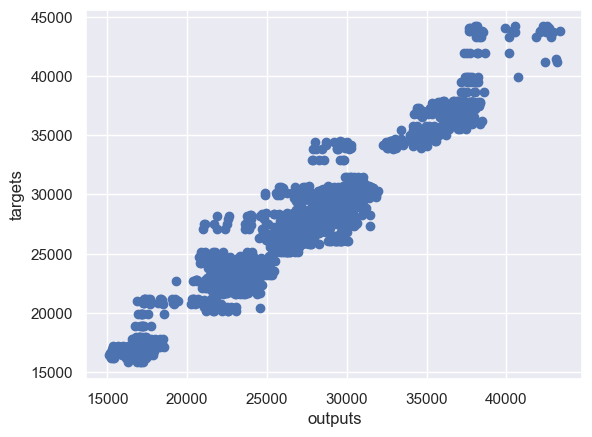

In [80]:
if più_output:
    plt.scatter(np.squeeze(modello_scelto.predict_on_batch(X_test)), np.squeeze(Y_test))
    plt.xlabel('outputs')
    plt.ylabel('targets')
    plt.show()
else:
    plt.scatter(np.squeeze(modello_scelto.predict_on_batch(X_test)), np.squeeze(y_test))
    plt.xlabel('outputs')
    plt.ylabel('targets')
    plt.show()

In [81]:
previsioni_totali_modello_scelto = modello_scelto.predict(X)

121/121 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


In [82]:
len(previsioni_totali_modello_scelto)

3843

In [83]:
# Conto il numero di colonne in X_train che contiene la parola "passato"
passato = sum('passato' in col for col in X_train.columns)
passato

30

In [84]:
df

,Timestamp,prezzo_presente,prezzo_passato_1,prezzo_passato_2,prezzo_passato_3,prezzo_passato_4,prezzo_passato_5,prezzo_passato_6,prezzo_passato_7,prezzo_passato_8,prezzo_passato_9,prezzo_passato_10,prezzo_passato_11,prezzo_passato_12,prezzo_passato_13,prezzo_passato_14,prezzo_passato_15,prezzo_passato_16,prezzo_passato_17,prezzo_passato_18,prezzo_passato_19,prezzo_passato_20,prezzo_passato_21,prezzo_passato_22,prezzo_passato_23,prezzo_passato_24,prezzo_passato_25,prezzo_passato_26,prezzo_passato_27,prezzo_passato_28,prezzo_passato_29,prezzo_passato_30,prezzo_futuro_1,prezzo_futuro_2,prezzo_futuro_3,prezzo_futuro_4,prezzo_futuro_5,prezzo_futuro_6,prezzo_futuro_7
0,2013-05-28,129.18,128.99,134.60,130.77,131.70,125.75,123.00,122.90,122.58,120.50,123.88,123.10,115.50,114.16,114.50,117.18,114.71,113.01,118.78,113.00,112.64,106.40,118.33,116.79,111.25,91.01,103.43,117.00,135.30,141.96,135.30,132.13,127.40,127.98,129.09,121.30,121.16,121.31
1,2013-05-29,132.13,129.18,128.99,134.60,130.77,131.70,125.75,123.00,122.90,122.58,120.50,123.88,123.10,115.50,114.16,114.50,117.18,114.71,113.01,118.78,113.00,112.64,106.40,118.33,116.79,111.25,91.01,103.43,117.00,135.30,141.96,127.40,127.98,129.09,121.30,121.16,121.31,121.71
2,2013-05-30,127.40,132.13,129.18,128.99,134.60,130.77,131.70,125.75,123.00,122.90,122.58,120.50,123.88,123.10,115.50,114.16,114.50,117.18,114.71,113.01,118.78,113.00,112.64,106.40,118.33,116.79,111.25,91.01,103.43,117.00,135.30,127.98,129.09,121.30,121.16,121.31,121.71,119.00
3,2013-05-31,127.98,127.40,132.13,129.18,128.99,134.60,130.77,131.70,125.75,123.00,122.90,122.58,120.50,123.88,123.10,115.50,114.16,114.50,117.18,114.71,113.01,118.78,113.00,112.64,106.40,118.33,116.79,111.25,91.01,103.43,117.00,129.09,121.30,121.16,121.31,121.71,119.00,110.09
4,2013-06-01,129.09,127.98,127.40,132.13,129.18,128.99,134.60,130.77,131.70,125.75,123.00,122.90,122.58,120.50,123.88,123.10,115.50,114.16,114.50,117.18,114.71,113.01,118.78,113.00,112.64,106.40,118.33,116.79,111.25,91.01,103.43,121.30,121.16,121.31,121.71,119.00,110.09,108.40
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3838,2023-12-02,"38,688.26","37,711.82","37,810.35","37,802.24","37,250.17","37,491.84","37,809.85","37,738.93","37,293.32","37,464.83","35,965.36","37,489.30","37,413.99","36,582.37","36,527.76","36,201.52","37,903.66","35,545.20","36,549.16","37,067.70","37,122.72","37,344.25","36,768.42","35,795.08","35,436.54","35,031.27","35,061.93","35,048.41","34,731.38","34,924.06","35,457.45","39,481.67","39,960.28","41,974.33","44,105.94","43,788.29","43,270.12","44,202.18"
3839,2023-12-03,"39,481.67","38,688.26","37,711.82","37,810.35","37,802.24","37,250.17","37,491.84","37,809.85","37,738.93","37,293.32","37,464.83","35,965.36","37,489.30","37,413.99","36,582.37","36,527.76","36,201.52","37,903.66","35,545.20","36,549.16","37,067.70","37,122.72","37,344.25","36,768.42","35,795.08","35,436.54","35,031.27","35,061.93","35,048.41","34,731.38","34,924.06","39,960.28","41,974.33","44,105.94","43,788.29","43,270.12","44,202.18","43,745.49"
3840,2023-12-04,"39,960.28","39,481.67","38,688.26","37,711.82","37,810.35","37,802.24","37,250.17","37,491.84","37,809.85","37,738.93","37,293.32","37,464.83","35,965.36","37,489.30","37,413.99","36,582.37","36,527.76","36,201.52","37,903.66","35,545.20","36,549.16","37,067.70","37,122.72","37,344.25","36,768.42","35,795.08","35,436.54","35,031.27","35,061.93","35,048.41","34,731.38","41,974.33","44,105.94","43,788.29","43,270.12","44,202.18","43,745.49","43,757.96"
3841,2023-12-05,"41,974.33","39,960.28","39,481.67","38,688.26","37,711.82","37,810.35","37,802.24","37,250.17","37,491.84","37,809.85","37,738.93","37,293.32","37,464.83","35,965.36","37,489.30","37,413.99","36,582.37","36,527.76","36,201.52","37,903.66","35,545.20","36,549.16","37,067.70","37,122.72","37,344.25","36,768.42","35,795.08","35,436.54","35,031.27",

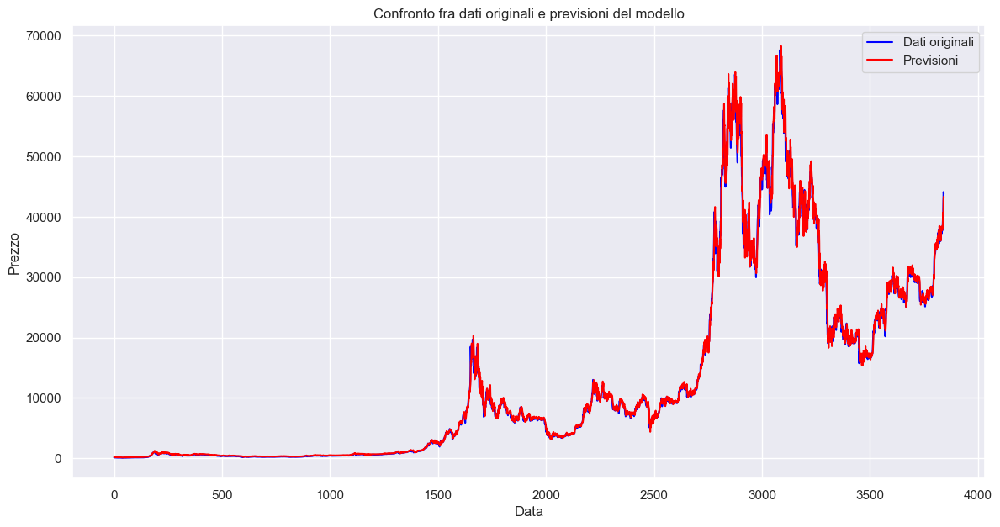

In [85]:
# Creo una colonna 'Previsioni' nel DataFrame originale
df['Previsioni'] = 0  # Inizializzo con valori dummy
df['Previsioni'] = previsioni_totali_modello_scelto

# Grafico dei dati originali e delle previsioni
plt.figure(figsize=(14, 7))
plt.plot(df.index, df['prezzo_futuro_1'], label='Dati originali', color='blue')
plt.plot(df.index, df['Previsioni'], label='Previsioni', color='red')
plt.title('Confronto fra dati originali e previsioni del modello')
plt.xlabel('Data')
plt.ylabel('Prezzo')
plt.legend()
plt.grid(True)
plt.show()

<h6> Performance random forest </h6>

In [87]:
if più_output:
    y_train = Y_train

print('Performance sul training set:')
# Ottengo le probabilità previste
predizioni_train = modello_scelto.predict(X_train)


print('\nMSE:')
mse_train = mean_squared_error(y_train, predizioni_train)
print(mse_train)

print('\nMAPE:')
mape_train = mean_absolute_percentage_error(y_train, predizioni_train)
print(f'{round(mape_train*100, 2)}%')

print('\nMAE:')
mae_train = mean_absolute_error(y_train, predizioni_train)
print(mae_train)

print('\nR^2:')
r2_train = r2_score(y_train, predizioni_train)
print(f'{round(r2_train*100, 2)}%')

prime_3_metriche = [mse_train, mape_train, mae_train]

print('\nMedia aritmetica di MSE, MAPE e MAE:')
media_train = np.mean(prime_3_metriche)
print(media_train)

pesi_media_pesata = {
    'MSE': 1,
    'MAPE': 5,
    'MAE': 1
}

print('\nMedia pesata di MSE, MAPE e MAE:')
media_pesata_train = sum(x * w for x, w in zip(prime_3_metriche, pesi_media_pesata.values())) / sum(pesi_media_pesata.values())
print(media_pesata_train)

Performance sul training set:
 1/97 ━━━━━━━━━━━━━━━━━━━━ 3s 41ms/step

97/97 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

MSE:
2131642.116457765

MAPE:
12.07%

MAE:
594.3072741080974

R^2:
98.85%

Media aritmetica di MSE, MAPE e MAE:
710745.5148256129

Media pesata di MSE, MAPE e MAE:
304605.2896366716


In [88]:
if più_output:
    y_val = Y_val

print('Performance sul validation set:')
# Ottengo le probabilità previste
predizioni_val = modello_scelto.predict(X_val)


print('\nMSE:')
mse_val = mean_squared_error(y_val, predizioni_val)
print(mse_val)

print('\nMAPE:')
mape_val = mean_absolute_percentage_error(y_val, predizioni_val)
print(f'{round(mape_val*100, 2)}%')

print('\nMAE:')
mae_val = mean_absolute_error(y_val, predizioni_val)
print(mae_val)

print('\nR^2:')
r2_val = r2_score(y_val, predizioni_val)
print(f'{round(r2_val*100, 2)}%')

prime_3_metriche = [mse_val, mape_val, mae_val]

print('\nMedia aritmetica di MSE, MAPE e MAE:')
media_val = np.mean(prime_3_metriche)
print(media_val)

pesi_media_pesata = {
    'MSE': 1,
    'MAPE': 5,
    'MAE': 1
}

print('\nMedia pesata di MSE, MAPE e MAE:')
media_pesata_val = sum(x * w for x, w in zip(prime_3_metriche, pesi_media_pesata.values())) / sum(pesi_media_pesata.values())
print(media_pesata_val)

Performance sul validation set:
 1/12 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step

12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 

MSE:
7191894.6128639905

MAPE:
5.86%

MAE:
1909.7206963419035

R^2:
95.87%

Media aritmetica di MSE, MAPE e MAE:
2397934.7973741614

Media pesata di MSE, MAPE e MAE:
1027686.3751958698


In [89]:
if più_output:
    y_test = Y_test

print('Performance sul test set:')
# Ottengo le probabilità previste
predizioni_test = modello_scelto.predict(X_test)


print('\nMSE:')
mse_test = mean_squared_error(y_test, predizioni_test)
print(mse_test)

print('\nMAPE:')
mape_test = mean_absolute_percentage_error(y_test, predizioni_test)
print(f'{round(mape_test*100, 2)}%')

print('\nMAE:')
mae_test = mean_absolute_error(y_test, predizioni_test)
print(mae_test)

print('\nR^2:')
r2_test = r2_score(y_test, predizioni_test)
print(f'{round(r2_test*100, 2)}%')

prime_3_metriche = [mse_test, mape_test, mae_test]

print('\nMedia aritmetica di MSE, MAPE e MAE:')
media_test = np.mean(prime_3_metriche)
print(media_test)

pesi_media_pesata = {
    'MSE': 1,
    'MAPE': 5,
    'MAE': 1
}

print('\nMedia pesata di MSE, MAPE e MAE:')
media_pesata_test = sum(x * w for x, w in zip(prime_3_metriche, pesi_media_pesata.values())) / sum(pesi_media_pesata.values())
print(media_pesata_test)

Performance sul test set:
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 

MSE:
2087488.6381577945

MAPE:
3.69%

MAE:
987.5135788225436

R^2:
93.78%

Media aritmetica di MSE, MAPE e MAE:
696158.7295563215

Media pesata di MSE, MAPE e MAE:
298353.76234262215


### Visualizzazione in Tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir "logs/fit"

### Regressione polinomiale (lineare)

In [6]:
import pandas as pd
df_senza_valori_nan_nuovo = pd.read_csv("Dataset Bitcoin+ esteso da me (passato_1500, futuro_30, periodo originale dal 28-4-2013 al 4-3-2024).csv")

In [7]:
df_senza_valori_nan_nuovo

,prezzo_presente,prezzo_passato_1,prezzo_passato_2,prezzo_passato_3,prezzo_passato_4,prezzo_passato_5,prezzo_passato_6,prezzo_passato_7,prezzo_passato_8,prezzo_passato_9,...,prezzo_futuro_24,prezzo_futuro_25,prezzo_futuro_26,prezzo_futuro_27,prezzo_futuro_28,prezzo_futuro_29,prezzo_futuro_30,Giorno,Mese,Anno
0,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,2228.136100,2173.665100,2072.354900,1939.995600,...,2204.251340,2266.818339,2299.748387,2296.449190,2287.340707,2200.484001,2248.614528,8,6,2017
1,2517.886400,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,2228.136100,2173.665100,2072.354900,...,2266.818339,2299.748387,2296.449190,2287.340707,2200.484001,2248.614528,2209.809631,9,6,2017
2,2623.630900,2517.886400,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,2228.136100,2173.665100,...,2299.748387,2296.449190,2287.340707,2200.484001,2248.614528,2209.809631,2073.873925,10,6,2017
3,2689.051900,2623.630900,2517.886400,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,2228.136100,...,2296.449190,2287.340707,2200.484001,2248.614528,2209.809631,2073.873925,2052.287611,11,6,2017
4,2413.900500,2689.051900,2623.630900,2517.886400,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,...,2287.340707,2200.484001,2248.614528,2209.809631,2073.873925,2052.287611,2091.209408,12,6,2017
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2427,39930.075700,38759.180185,38771.396298,38535.125270,36811.158551,36871.206159,36689.359739,36313.419449,38141.445735,38173.221525,...,47410.493801,46933.944013,47591.241230,47833.386650,50208.135988,52573.782675,57717.736389,30,1,2024
2428,39555.506056,39930.075700,38759.180185,38771.396298,38535.125270,36811.158551,36871.206159,36689.359739,36313.419449,38141.445735,...,46933.944013,47591.241230,47833.386650,50208.135988,52573.782675,57717.736389,56734.564616,31,1,2024
2429,39390.455612,39555.506056,39930.075700,38759.180185,38771.396298,38535.125270,36811.158551,36871.206159,36689.359739,36313.419449,...,47591.241230,47833.386650,50208.135988,52573.782675,57717.736389,56734.564616,57560.483900,1,2,2024
2430,39601.985426,39390.455612,39555.506056,39930.075700,38759.180185,38771.396298,38535.125270,36811.158551,36871.206159,36689.359739,...,47833.386650,50208.135988,52573.782675,57717.736389,56734.564616,57560.483900,57229.676585,2,2,2024


In [8]:
df_senza_valori_nan_nuovo.drop(['Giorno','Mese', 'Anno'], axis=1, inplace=True)
df_senza_valori_nan_nuovo

,prezzo_presente,prezzo_passato_1,prezzo_passato_2,prezzo_passato_3,prezzo_passato_4,prezzo_passato_5,prezzo_passato_6,prezzo_passato_7,prezzo_passato_8,prezzo_passato_9,...,prezzo_futuro_21,prezzo_futuro_22,prezzo_futuro_23,prezzo_futuro_24,prezzo_futuro_25,prezzo_futuro_26,prezzo_futuro_27,prezzo_futuro_28,prezzo_futuro_29,prezzo_futuro_30
0,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,2228.136100,2173.665100,2072.354900,1939.995600,...,2238.963369,2179.708192,2135.587135,2204.251340,2266.818339,2299.748387,2296.449190,2287.340707,2200.484001,2248.614528
1,2517.886400,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,2228.136100,2173.665100,2072.354900,...,2179.708192,2135.587135,2204.251340,2266.818339,2299.748387,2296.449190,2287.340707,2200.484001,2248.614528,2209.809631
2,2623.630900,2517.886400,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,2228.136100,2173.665100,...,2135.587135,2204.251340,2266.818339,2299.748387,2296.449190,2287.340707,2200.484001,2248.614528,2209.809631,2073.873925
3,2689.051900,2623.630900,2517.886400,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,2228.136100,...,2204.251340,2266.818339,2299.748387,2296.449190,2287.340707,2200.484001,2248.614528,2209.809631,2073.873925,2052.287611
4,2413.900500,2689.051900,2623.630900,2517.886400,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,...,2266.818339,2299.748387,2296.449190,2287.340707,2200.484001,2248.614528,2209.809631,2073.873925,2052.287611,2091.209408
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2427,39930.075700,38759.180185,38771.396298,38535.125270,36811.158551,36871.206159,36689.359739,36313.419449,38141.445735,38173.221525,...,48043.597882,48367.898536,47916.290054,47410.493801,46933.944013,47591.241230,47833.386650,50208.135988,52573.782675,57717.736389
2428,39555.506056,39930.075700,38759.180185,38771.396298,38535.125270,36811.158551,36871.206159,36689.359739,36313.419449,38141.445735,...,48367.898536,47916.290054,47410.493801,46933.944013,47591.241230,47833.386650,50208.135988,52573.782675,57717.736389,56734.564616
2429,39390.455612,39555.506056,39930.075700,38759.180185,38771.396298,38535.125270,36811.158551,36871.206159,36689.359739,36313.419449,...,47916.290054,47410.493801,46933.944013,47591.241230,47833.386650,50208.135988,52573.782675,57717.736389,56734.564616,57560.483900
2430,39601.985426,39390.455612,39555.506056,39930.075700,38759.180185,38771.396298,38535.125270,36811.158551,36871.206159,36689.359739,...,47410.493801,46933.944013,47591.241230,47833.386650,50208.135988,52573.782675,57717.736389,56734.564616,57560.483900,57229.676585


In [11]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Carica il tuo dataset (assumendo che sia un DataFrame pandas)
# Assicurati di avere importato tutte le librerie necessarie

# Supponiamo che 'dataset' sia il tuo DataFrame
features = df_senza_valori_nan_nuovo.iloc[:, :-30]  # Seleziona tutte le colonne tranne le ultime sette (e Timestamp)
targets = df_senza_valori_nan_nuovo.iloc[:, -30:]    # Seleziona solo le ultime sette colonne

# Divido il dataset in set di addestramento e test in modo casuale
# X_train, X_test, y_train, y_test = train_test_split(features, targets, test_size=0.2, random_state=42)

# Divido il dataset in set di addestramento e test in modo continuo
train_size = int(0.8 * len(features))
X_train, y_train = features[:train_size], targets[:train_size]
X_test, y_test = features[train_size:], targets[train_size:]

# Applica la regressione polinomiale a ciascun target
# degree = 1  # Puoi regolare il grado del polinomio
# poly = PolynomialFeatures(degree=degree)

# Addestra un modello separato per ciascun target
models = []
for i in range(targets.shape[1]):
    y_train_target = y_train.iloc[:, i]
    # X_train_poly = poly.fit_transform(X_train)
    model = LinearRegression()
    model.fit(X_train, y_train_target)
    models.append(model)

# Valuta le prestazioni di ciascun modello
y_preds = []
lista_mse = []
lista_mae = []
lista_mape = []
for i, model in enumerate(models):
    # X_test_poly = poly.transform(X_test)
    y_pred = model.predict(X_test)
    mse = mean_squared_error(y_test.iloc[:, i], y_pred)
    lista_mse.append(mse)
    mae = mean_absolute_error(y_test.iloc[:, i], y_pred)
    lista_mae.append(mae)
    mape = mean_absolute_percentage_error(y_test.iloc[:, i], y_pred)
    lista_mape.append(mape)
    print(f'MSE for Target {i+1}: {mse}')
    print(f'MAE for Target {i+1}: {mae}')
    print(f'MAPE for Target {i+1}: {mape}\n')
    y_preds.append(y_pred)

print(f'MSE medio per tutti i target: {np.mean(lista_mse)}')
print(f'MAE medio per tutti i target: {np.mean(lista_mae)}')
print(f'MAPE medio per tutti i target: {np.mean(lista_mape)}')

# Nota: y_preds contiene le previsioni per ciascun target

MSE for Target 1: 29603505.433227498
MAE for Target 1: 4375.454900512972
MAPE for Target 1: 0.17623506093992813

MSE for Target 2: 76740340.3856403
MAE for Target 2: 7153.445069459927
MAPE for Target 2: 0.29042403054078564

MSE for Target 3: 140469765.54466715
MAE for Target 3: 9735.809141993755
MAPE for Target 3: 0.39572964093062907

MSE for Target 4: 210729723.25074112
MAE for Target 4: 11950.217004340346
MAPE for Target 4: 0.48621649164167113

MSE for Target 5: 277432147.47938526
MAE for Target 5: 13669.846046614091
MAPE for Target 5: 0.5558672687430616

MSE for Target 6: 327138929.93382674
MAE for Target 6: 14801.983757990174
MAPE for Target 6: 0.6007046640244412

MSE for Target 7: 359559668.6534863
MAE for Target 7: 15420.233846478493
MAPE for Target 7: 0.6241857047854498

MSE for Target 8: 373661873.366267
MAE for Target 8: 15476.484029680683
MAPE for Target 8: 0.6239312909124426

MSE for Target 9: 365404734.9980805
MAE for Target 9: 15074.791020714303
MAPE for Target 9: 0.603643

In [130]:
models[0].coef_

array([ 0.9621493 ,  0.06895919,  0.01257839, -0.01652664,  0.02352628,
       -0.04730702, -0.05866118,  0.00804209,  0.11088197,  0.02773979,
       -0.08790092, -0.08077203,  0.12594587, -0.05117165, -0.05843625,
        0.02193374,  0.06979628, -0.04336186, -0.01826013,  0.11136025,
       -0.12713117,  0.03006561, -0.05598053,  0.11516364, -0.04281105,
        0.05211375,  0.00798732,  0.00869331, -0.12605735,  0.0639731 ,
       -0.00564143])

In [131]:
import joblib

# Salva il modello utilizzando joblib
joblib.dump(models, 'modello.h5')

['modello.h5']

### Regressione polinomiale (generica)

In [12]:
import pandas as pd
df_senza_valori_nan_nuovo = pd.read_csv("Dataset Bitcoin+ esteso da me (passato_1500, futuro_30, periodo originale dal 28-4-2013 al 4-3-2024).csv")

In [13]:
df_senza_valori_nan_nuovo

,prezzo_presente,prezzo_passato_1,prezzo_passato_2,prezzo_passato_3,prezzo_passato_4,prezzo_passato_5,prezzo_passato_6,prezzo_passato_7,prezzo_passato_8,prezzo_passato_9,...,prezzo_futuro_24,prezzo_futuro_25,prezzo_futuro_26,prezzo_futuro_27,prezzo_futuro_28,prezzo_futuro_29,prezzo_futuro_30,Giorno,Mese,Anno
0,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,2228.136100,2173.665100,2072.354900,1939.995600,...,2204.251340,2266.818339,2299.748387,2296.449190,2287.340707,2200.484001,2248.614528,8,6,2017
1,2517.886400,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,2228.136100,2173.665100,2072.354900,...,2266.818339,2299.748387,2296.449190,2287.340707,2200.484001,2248.614528,2209.809631,9,6,2017
2,2623.630900,2517.886400,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,2228.136100,2173.665100,...,2299.748387,2296.449190,2287.340707,2200.484001,2248.614528,2209.809631,2073.873925,10,6,2017
3,2689.051900,2623.630900,2517.886400,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,2228.136100,...,2296.449190,2287.340707,2200.484001,2248.614528,2209.809631,2073.873925,2052.287611,11,6,2017
4,2413.900500,2689.051900,2623.630900,2517.886400,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,...,2287.340707,2200.484001,2248.614528,2209.809631,2073.873925,2052.287611,2091.209408,12,6,2017
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2427,39930.075700,38759.180185,38771.396298,38535.125270,36811.158551,36871.206159,36689.359739,36313.419449,38141.445735,38173.221525,...,47410.493801,46933.944013,47591.241230,47833.386650,50208.135988,52573.782675,57717.736389,30,1,2024
2428,39555.506056,39930.075700,38759.180185,38771.396298,38535.125270,36811.158551,36871.206159,36689.359739,36313.419449,38141.445735,...,46933.944013,47591.241230,47833.386650,50208.135988,52573.782675,57717.736389,56734.564616,31,1,2024
2429,39390.455612,39555.506056,39930.075700,38759.180185,38771.396298,38535.125270,36811.158551,36871.206159,36689.359739,36313.419449,...,47591.241230,47833.386650,50208.135988,52573.782675,57717.736389,56734.564616,57560.483900,1,2,2024
2430,39601.985426,39390.455612,39555.506056,39930.075700,38759.180185,38771.396298,38535.125270,36811.158551,36871.206159,36689.359739,...,47833.386650,50208.135988,52573.782675,57717.736389,56734.564616,57560.483900,57229.676585,2,2,2024


In [14]:
df_senza_valori_nan_nuovo.drop(['Giorno','Mese', 'Anno'], axis=1, inplace=True)
df_senza_valori_nan_nuovo

,prezzo_presente,prezzo_passato_1,prezzo_passato_2,prezzo_passato_3,prezzo_passato_4,prezzo_passato_5,prezzo_passato_6,prezzo_passato_7,prezzo_passato_8,prezzo_passato_9,...,prezzo_futuro_21,prezzo_futuro_22,prezzo_futuro_23,prezzo_futuro_24,prezzo_futuro_25,prezzo_futuro_26,prezzo_futuro_27,prezzo_futuro_28,prezzo_futuro_29,prezzo_futuro_30
0,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,2228.136100,2173.665100,2072.354900,1939.995600,...,2238.963369,2179.708192,2135.587135,2204.251340,2266.818339,2299.748387,2296.449190,2287.340707,2200.484001,2248.614528
1,2517.886400,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,2228.136100,2173.665100,2072.354900,...,2179.708192,2135.587135,2204.251340,2266.818339,2299.748387,2296.449190,2287.340707,2200.484001,2248.614528,2209.809631
2,2623.630900,2517.886400,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,2228.136100,2173.665100,...,2135.587135,2204.251340,2266.818339,2299.748387,2296.449190,2287.340707,2200.484001,2248.614528,2209.809631,2073.873925
3,2689.051900,2623.630900,2517.886400,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,2228.136100,...,2204.251340,2266.818339,2299.748387,2296.449190,2287.340707,2200.484001,2248.614528,2209.809631,2073.873925,2052.287611
4,2413.900500,2689.051900,2623.630900,2517.886400,2520.805200,2412.539200,2573.405500,2418.635100,2266.554700,2271.276500,...,2266.818339,2299.748387,2296.449190,2287.340707,2200.484001,2248.614528,2209.809631,2073.873925,2052.287611,2091.209408
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2427,39930.075700,38759.180185,38771.396298,38535.125270,36811.158551,36871.206159,36689.359739,36313.419449,38141.445735,38173.221525,...,48043.597882,48367.898536,47916.290054,47410.493801,46933.944013,47591.241230,47833.386650,50208.135988,52573.782675,57717.736389
2428,39555.506056,39930.075700,38759.180185,38771.396298,38535.125270,36811.158551,36871.206159,36689.359739,36313.419449,38141.445735,...,48367.898536,47916.290054,47410.493801,46933.944013,47591.241230,47833.386650,50208.135988,52573.782675,57717.736389,56734.564616
2429,39390.455612,39555.506056,39930.075700,38759.180185,38771.396298,38535.125270,36811.158551,36871.206159,36689.359739,36313.419449,...,47916.290054,47410.493801,46933.944013,47591.241230,47833.386650,50208.135988,52573.782675,57717.736389,56734.564616,57560.483900
2430,39601.985426,39390.455612,39555.506056,39930.075700,38759.180185,38771.396298,38535.125270,36811.158551,36871.206159,36689.359739,...,47410.493801,46933.944013,47591.241230,47833.386650,50208.135988,52573.782675,57717.736389,56734.564616,57560.483900,57229.676585


In [16]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Carica il tuo dataset (assumendo che sia un DataFrame pandas)
# Assicurati di avere importato tutte le librerie necessarie

# Supponiamo che 'dataset' sia il tuo DataFrame
features = df_senza_valori_nan_nuovo.iloc[:, :-30]  # Seleziona tutte le colonne tranne le ultime sette (e Timestamp)
targets = df_senza_valori_nan_nuovo.iloc[:, -30:]    # Seleziona solo le ultime sette colonne

# Divido il dataset in set di addestramento e test in modo casuale
# X_train, X_test, y_train, y_test = train_test_split(features, targets, test_size=0.2, random_state=42)

# Divido il dataset in set di addestramento e test in modo continuo
train_size = int(0.8 * len(features))
X_train, y_train = features[:train_size], targets[:train_size]
X_test, y_test = features[train_size:], targets[train_size:]

# Applica la regressione polinomiale a ciascun target
degree = 1  # Puoi regolare il grado del polinomio
poly = PolynomialFeatures(degree=degree)

# Addestra un modello separato per ciascun target
models = []
for i in range(targets.shape[1]):
    y_train_target = y_train.iloc[:, i]
    X_train_poly = poly.fit_transform(X_train)
    model = LinearRegression()
    model.fit(X_train_poly, y_train_target)
    models.append(model)

# Valuta le prestazioni di ciascun modello
y_preds = []
lista_mse = []
lista_mae = []
lista_mape = []
for i, model in enumerate(models):
    X_test_poly = poly.transform(X_test)
    y_pred = model.predict(X_test_poly)
    mse = mean_squared_error(y_test.iloc[:, i], y_pred)
    lista_mse.append(mse)
    mae = mean_absolute_error(y_test.iloc[:, i], y_pred)
    lista_mae.append(mae)
    mape = mean_absolute_percentage_error(y_test.iloc[:, i], y_pred)
    lista_mape.append(mape)
    print(f'MSE for Target {i+1}: {mse}')
    print(f'MAE for Target {i+1}: {mae}')
    print(f'MAPE for Target {i+1}: {mape}\n')
    y_preds.append(y_pred)

print(f'MSE medio per tutti i target: {np.mean(lista_mse)}')
print(f'MAE medio per tutti i target: {np.mean(lista_mae)}')
print(f'MAPE medio per tutti i target: {np.mean(lista_mape)}')

# Nota: y_preds contiene le previsioni per ciascun target

MSE for Target 1: 29603505.433226913
MAE for Target 1: 4375.454900512893
MAPE for Target 1: 0.17623506093992433

MSE for Target 2: 76740340.38564384
MAE for Target 2: 7153.44506946007
MAPE for Target 2: 0.2904240305407932

MSE for Target 3: 140469765.54466248
MAE for Target 3: 9735.809141993725
MAPE for Target 3: 0.39572964093063046

MSE for Target 4: 210729723.25073248
MAE for Target 4: 11950.217004340226
MAPE for Target 4: 0.48621649164166897

MSE for Target 5: 277432147.4793767
MAE for Target 5: 13669.846046614111
MAPE for Target 5: 0.5558672687430662

MSE for Target 6: 327138929.93380934
MAE for Target 6: 14801.983757989823
MAPE for Target 6: 0.6007046640244312

MSE for Target 7: 359559668.65345746
MAE for Target 7: 15420.233846477777
MAPE for Target 7: 0.624185704785429

MSE for Target 8: 373661873.36625904
MAE for Target 8: 15476.48402968082
MAPE for Target 8: 0.6239312909124526

MSE for Target 9: 365404734.9980712
MAE for Target 9: 15074.791020714416
MAPE for Target 9: 0.6036432

In [19]:
models[0].coef_

array([ 1.41958513e-12,  1.00323798e+00, -2.41475906e-02, ...,
       -4.47095130e-01, -2.91271611e-01,  2.70494843e-01])

In [9]:
import joblib

# Salva il modello utilizzando joblib
joblib.dump(models, 'modello 1500.h5')

['modello 1500.h5']

### Creo un nuovo dataframe con nuove colonne

In [145]:
# Concateno i DataFrame X_train, X_val e X_test verticalmente
X_concatenato = pd.concat([X_train, X_val, X_test], axis=0)

# Concateno le etichette target y_train, y_val e y_test verticalmente
y_concatenato = pd.concat([y_train, y_val, y_test], axis=0)

# Creo una colonna 'Origine' con i flag che indicano l'origine dei dati
origine_train = ['Train'] * len(X_train)
origine_val = ['Test_1'] * len(X_val)
origine_test = ['Test out-of-sample'] * len(X_test)

origine = origine_train + origine_val + origine_test

# Creo un nuovo DataFrame con tutte le colonne desiderate
df_completo = pd.DataFrame(data=X_concatenato)
df_completo['Target_95'] = y_concatenato
df_completo['Origine'] = origine

df_completo

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95,Origine
36698,52.0000,1.5208,2.2500,0.0434,5000.0000,12.0000,276.2500,0.0000,4.0000,999.0000,1126.0000,0.7708,1407.7700,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,Train
90092,50.0000,0.6181,1.1667,0.0000,19586.0000,12.0000,263.2400,1.0000,3.0833,14.0000,456.0000,0.4054,17528.0300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,Train
156,24.0000,1.3452,1.5714,0.2015,1500.0000,6.0000,90.0600,1.0000,2.0000,16.0000,183.0000,0.2500,1218.7400,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,Train
37624,52.0000,0.7014,1.1667,0.0387,16439.9000,12.0000,310.2200,0.0000,7.0000,28.0000,2434.0000,0.9524,1266.7900,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,Train
69227,41.0000,0.5417,1.0000,0.0000,14224.0000,12.0000,252.0700,1.0000,8.0000,15.0000,1743.0000,0.5938,7217.5800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84799,42.0000,0.4931,0.9167,0.0000,2528.7500,5.0000,49.2700,1.0000,3.0000,15.0000,668.0000,0.6111,1032.6700,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,1,0,1,Test out-of-sample
23810,57.0000,0.5667,0.8000,0.4366,2000.0000,8.0000,299.7500,2.0000,1.0000,29.0000,272.0000,0.7500,668.1400,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,Test out-of-sample
23132,30.0000,0.7083,1.2500,0.0493,2450.0000,12.0000,243.5100,2.0000,2.0000,31.0000,670.0000,0.9167,337.7800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,Test out-of-sample
83040,60.0000,0.5417,1.0000,0.0965,5577.0000,12.0000,124.3800,1.0000,6.0000,17.0000,1673.0000,0.7639,1732.0900,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,Test out-of-sample


In [146]:
ordine_colonne = dummies.columns
ordine_colonne

Index(['Target_95', 'Eta_Debitore', 'Severity_12M_pesata', 'Severity_12M',
       'RATIO_ONERI_AFF_TOT_AFF', 'IMP_FINANZIATO', 'Numero_mesi_rec',
       'TOT_AFF', 'DistanzaAffidoUltimoPagamento', 'DurataFinanziamentoAnni',
       'AgeingGestioneGg', 'AgeingErogazioneGg', 'Ratio_Rate_Imp1',
       'Cash Balance', 'Nazionalita_Italiano', 'Nazionalita_Non Valutabile',
       'Sesso_Non Valutabile', 'Sesso_Uomo',
       'Denominazione Regione_Basilicata', 'Denominazione Regione_Calabria',
       'Denominazione Regione_Campania',
       'Denominazione Regione_Emilia-Romagna',
       'Denominazione Regione_Friuli-Venezia Giulia',
       'Denominazione Regione_Lazio', 'Denominazione Regione_Liguria',
       'Denominazione Regione_Lombardia', 'Denominazione Regione_Marche',
       'Denominazione Regione_Molise', 'Denominazione Regione_Non Valutabile',
       'Denominazione Regione_Piemonte', 'Denominazione Regione_Puglia',
       'Denominazione Regione_Sardegna', 'Denominazione Regione_Sicili

In [147]:
# Calcolo le probabilità continue utilizzando il mio modello_scelto
features = ordine_colonne.drop('Target_95')

probabilità_continue = modello_scelto.predict_proba(df_completo[features])

# Estraggo le probabilità relative alla classe 1
probabilità_classe_1 = probabilità_continue[:, 1]

# Aggiungo una nuova colonna al DataFrame df_completo con le probabilità continue
df_completo['Probabilità_Target_95_predicted'] = probabilità_classe_1

df_completo

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95,Origine,Probabilità_Target_95_predicted
36698,52.0000,1.5208,2.2500,0.0434,5000.0000,12.0000,276.2500,0.0000,4.0000,999.0000,1126.0000,0.7708,1407.7700,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,Train,0.0101
90092,50.0000,0.6181,1.1667,0.0000,19586.0000,12.0000,263.2400,1.0000,3.0833,14.0000,456.0000,0.4054,17528.0300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,Train,0.8600
156,24.0000,1.3452,1.5714,0.2015,1500.0000,6.0000,90.0600,1.0000,2.0000,16.0000,183.0000,0.2500,1218.7400,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,Train,0.1000
37624,52.0000,0.7014,1.1667,0.0387,16439.9000,12.0000,310.2200,0.0000,7.0000,28.0000,2434.0000,0.9524,1266.7900,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,Train,0.0918
69227,41.0000,0.5417,1.0000,0.0000,14224.0000,12.0000,252.0700,1.0000,8.0000,15.0000,1743.0000,0.5938,7217.5800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.7969
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84799,42.0000,0.4931,0.9167,0.0000,2528.7500,5.0000,49.2700,1.0000,3.0000,15.0000,668.0000,0.6111,1032.6700,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,1,0,1,Test out-of-sample,0.7327
23810,57.0000,0.5667,0.8000,0.4366,2000.0000,8.0000,299.7500,2.0000,1.0000,29.0000,272.0000,0.7500,668.1400,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,Test out-of-sample,0.0350
23132,30.0000,0.7083,1.2500,0.0493,2450.0000,12.0000,243.5100,2.0000,2.0000,31.0000,670.0000,0.9167,337.7800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,Test out-of-sample,0.3310
83040,60.0000,0.5417,1.0000,0.0965,5577.0000,12.0000,124.3800,1.0000,6.0000,17.0000,1673.0000,0.7639,1732.0900,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,Test out-of-sample,0.1593


In [148]:
df_completo.index

Int64Index([ 36698,  90092,    156,  37624,  69227, 102293,  63860,  72023,
             90078,  78772,
            ...
              4750,  73475,  66619,  74954,  66272,  84799,  23810,  23132,
             83040,  41883],
           dtype='int64', length=113621)

In [149]:
# Controllo se in df_clienti c'erano certe colonne
lista_check = ['CODICE_PHONIA', 'TOT REC', 'PRATICA', 'Chiave', 'TOT AFF']

sono_presenti_tutti = all(colonna in df_clienti.columns for colonna in lista_check)
sono_presenti_tutti

True

In [150]:
sorted(df_clienti.columns)

['AgeingErogazioneGg',
 'AgeingGestioneGg',
 'CODICE_PHONIA',
 'COD_FISC_INT',
 'CURRENT_BALANCE',
 'Cash Balance',
 'Chiave',
 'Codi_FISC_INT_2',
 'DATA AFFIDO',
 'DATA FINE LAV',
 'DATA_AFFIDO',
 'DATA_AGGIORNAMENTO',
 'DATA_ESTINZ',
 'DATA_FINANZIAM',
 'DATA_FINE_AFFIDO',
 'DELIN_HISTORY',
 'DES_BENE',
 'DES_PRODOTTO',
 'DT_VAL_RAT_IMP1',
 'DT_VAL_RAT_IMP2',
 'DT_VAL_ULT_PAGAM',
 'Denominazione Regione',
 'DistanzaAffidoUltimoPagamento',
 'DurataFinanziamentoAnni',
 'Eta_Debitore',
 'FlagRecOver100',
 'Flag_Cointestazione',
 'Flag_Galleggiamento_3M',
 'Flag_Galleggiamento_6M',
 'Flag_Garante',
 'Flag_Gestione_Prec',
 'Flag_InsolvenzaGrave_12M',
 'Flag_InsolvenzaGrave_3M',
 'Flag_InsolvenzaGrave_6M',
 'Flag_Miglioramento_3M',
 'Flag_Rate_piu_uno',
 'Flag_Riciclo_SDD',
 'Flag_Rifinanziamento',
 'Flag_Scivolamento_3M',
 'Flag_Scivolamento_6M',
 'Flag_rientrototale_6M',
 'IMP_FINANZIATO',
 'IMP_MAXIRATA',
 'IMP_PAG_RAT_IMP1',
 'IMP_PAG_RAT_IMP2',
 'IMP_RAT_IMP1',
 'IMP_RAT_IMP2',
 'MACR

In [151]:
df_completo

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95,Origine,Probabilità_Target_95_predicted
36698,52.0000,1.5208,2.2500,0.0434,5000.0000,12.0000,276.2500,0.0000,4.0000,999.0000,1126.0000,0.7708,1407.7700,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,Train,0.0101
90092,50.0000,0.6181,1.1667,0.0000,19586.0000,12.0000,263.2400,1.0000,3.0833,14.0000,456.0000,0.4054,17528.0300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,Train,0.8600
156,24.0000,1.3452,1.5714,0.2015,1500.0000,6.0000,90.0600,1.0000,2.0000,16.0000,183.0000,0.2500,1218.7400,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,Train,0.1000
37624,52.0000,0.7014,1.1667,0.0387,16439.9000,12.0000,310.2200,0.0000,7.0000,28.0000,2434.0000,0.9524,1266.7900,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,Train,0.0918
69227,41.0000,0.5417,1.0000,0.0000,14224.0000,12.0000,252.0700,1.0000,8.0000,15.0000,1743.0000,0.5938,7217.5800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.7969
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84799,42.0000,0.4931,0.9167,0.0000,2528.7500,5.0000,49.2700,1.0000,3.0000,15.0000,668.0000,0.6111,1032.6700,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,1,0,1,Test out-of-sample,0.7327
23810,57.0000,0.5667,0.8000,0.4366,2000.0000,8.0000,299.7500,2.0000,1.0000,29.0000,272.0000,0.7500,668.1400,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,Test out-of-sample,0.0350
23132,30.0000,0.7083,1.2500,0.0493,2450.0000,12.0000,243.5100,2.0000,2.0000,31.0000,670.0000,0.9167,337.7800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,Test out-of-sample,0.3310
83040,60.0000,0.5417,1.0000,0.0965,5577.0000,12.0000,124.3800,1.0000,6.0000,17.0000,1673.0000,0.7639,1732.0900,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,Test out-of-sample,0.1593


In [152]:
# df_completo = df_completo.merge(df_clienti[lista_check], left_on=lista_colonne, right_on=lista_colonne, how='left')

In [153]:
# Faccio una left join per agganciarmi le colonne di lista_check
df_completo = df_completo.merge(df_clienti[lista_check], left_index=True, right_index=True, how='left')

In [154]:
df_completo

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95,Origine,Probabilità_Target_95_predicted,CODICE_PHONIA,TOT REC,PRATICA,Chiave,TOT AFF
36698,52.0000,1.5208,2.2500,0.0434,5000.0000,12.0000,276.2500,0.0000,4.0000,999.0000,1126.0000,0.7708,1407.7700,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,Train,0.0101,ALPTEL,0.0000,00001529616301,00001529616301_10_2022,258.0000
90092,50.0000,0.6181,1.1667,0.0000,19586.0000,12.0000,263.2400,1.0000,3.0833,14.0000,456.0000,0.4054,17528.0300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,Train,0.8600,AQPTEL,293.8500,00002365625301,00002365625301_08_2022,293.8500
156,24.0000,1.3452,1.5714,0.2015,1500.0000,6.0000,90.0600,1.0000,2.0000,16.0000,183.0000,0.2500,1218.7400,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,Train,0.1000,AHPTEL,0.0000,00002273002301,00002273002301_09_2021,89.1500
37624,52.0000,0.7014,1.1667,0.0387,16439.9000,12.0000,310.2200,0.0000,7.0000,28.0000,2434.0000,0.9524,1266.7900,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,Train,0.0918,ALPTEL,259.1500,00005924519200,00005924519200_11_2022,530.3000
69227,41.0000,0.5417,1.0000,0.0000,14224.0000,12.0000,252.0700,1.0000,8.0000,15.0000,1743.0000,0.5938,7217.5800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.7969,ALPTEX,415.3000,00000863025301,00000863025301_04_2023,427.3000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84799,42.0000,0.4931,0.9167,0.0000,2528.7500,5.0000,49.2700,1.0000,3.0000,15.0000,668.0000,0.6111,1032.6700,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,1,0,1,Test out-of-sample,0.7327,AQPTEL,73.2400,00001990587301,00001990587301_05_2022,73.2400
23810,57.0000,0.5667,0.8000,0.4366,2000.0000,8.0000,299.7500,2.0000,1.0000,29.0000,272.0000,0.7500,668.1400,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,Test out-of-sample,0.0350,ALPTEL,336.3400,00002269045301,00002269045301_11_2021,467.2200
23132,30.0000,0.7083,1.2500,0.0493,2450.0000,12.0000,243.5100,2.0000,2.0000,31.0000,670.0000,0.9167,337.7800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,

In [155]:
df_completo['Target_95_predicted'] = round(df_completo['Probabilità_Target_95_predicted'])

In [156]:
# df_completo.rename(columns={'Target_95_continuo': 'Probabilità_Target_95_predicted'}, inplace=True)

In [157]:
df_completo

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95,Origine,Probabilità_Target_95_predicted,CODICE_PHONIA,TOT REC,PRATICA,Chiave,TOT AFF,Target_95_predicted
36698,52.0000,1.5208,2.2500,0.0434,5000.0000,12.0000,276.2500,0.0000,4.0000,999.0000,1126.0000,0.7708,1407.7700,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,Train,0.0101,ALPTEL,0.0000,00001529616301,00001529616301_10_2022,258.0000,0.0000
90092,50.0000,0.6181,1.1667,0.0000,19586.0000,12.0000,263.2400,1.0000,3.0833,14.0000,456.0000,0.4054,17528.0300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,Train,0.8600,AQPTEL,293.8500,00002365625301,00002365625301_08_2022,293.8500,1.0000
156,24.0000,1.3452,1.5714,0.2015,1500.0000,6.0000,90.0600,1.0000,2.0000,16.0000,183.0000,0.2500,1218.7400,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,Train,0.1000,AHPTEL,0.0000,00002273002301,00002273002301_09_2021,89.1500,0.0000
37624,52.0000,0.7014,1.1667,0.0387,16439.9000,12.0000,310.2200,0.0000,7.0000,28.0000,2434.0000,0.9524,1266.7900,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,Train,0.0918,ALPTEL,259.1500,00005924519200,00005924519200_11_2022,530.3000,0.0000
69227,41.0000,0.5417,1.0000,0.0000,14224.0000,12.0000,252.0700,1.0000,8.0000,15.0000,1743.0000,0.5938,7217.5800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.7969,ALPTEX,415.3000,00000863025301,00000863025301_04_2023,427.3000,1.0000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84799,42.0000,0.4931,0.9167,0.0000,2528.7500,5.0000,49.2700,1.0000,3.0000,15.0000,668.0000,0.6111,1032.6700,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,1,0,1,Test out-of-sample,0.7327,AQPTEL,73.2400,00001990587301,00001990587301_05_2022,73.2400,1.0000
23810,57.0000,0.5667,0.8000,0.4366,2000.0000,8.0000,299.7500,2.0000,1.0000,29.0000,272.0000,0.7500,668.1400,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,Test out-of-sample,0.0350,ALPTEL,336.3400,00002269045301,00002269045301_11_2021,467.2200,0.0000
23132,30.0000,0.7083,1.2500,0.0493,2450.0000,12.0000,243.5100,2.0000,2.0000,31.0

<h6> Concateno i dati sintetici </h6>

In [158]:
X_sintetici = X_res[len(X_train):]

In [159]:
X_sintetici.shape

(20668, 55)

In [160]:
y_sintetici = y_res[len(y_train):]

In [161]:
y_sintetici.shape

(20668,)

In [162]:
set(df_completo.columns) - set(X_sintetici.columns)

{'CODICE_PHONIA',
 'Chiave',
 'Origine',
 'PRATICA',
 'Probabilità_Target_95_predicted',
 'TOT AFF',
 'TOT REC',
 'Target_95',
 'Target_95_predicted'}

In [163]:
set(X_sintetici.columns) - set(df_completo.columns)

set()

In [164]:
df_sintetici = pd.concat([X_sintetici, y_sintetici], axis=1)

In [165]:
df_sintetici

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95
92032,46.9806,0.1563,0.2885,0.5846,14326.3909,3.4618,66.1899,0.2885,10.0000,17.7115,1460.1593,0.3929,9939.4399,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1
92033,46.7984,0.4731,0.8061,0.0000,1329.0872,6.9278,49.7829,5.6540,2.5000,15.0000,364.4183,0.4000,866.9003,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,1
92034,52.5375,0.4815,0.7873,0.0000,2663.6558,7.2903,106.0876,1.3011,2.3495,15.6021,367.6024,0.4283,1674.8231,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
92035,49.9968,0.1738,0.2504,0.0000,6060.9129,1.0022,147.0398,4.9978,4.0000,15.9995,1003.0000,0.6875,2203.7816,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1
92036,42.1884,0.1377,0.1377,0.0000,7285.5071,1.0000,131.7592,2.0000,5.8068,16.0000,191.9856,0.0909,6872.1661,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112695,50.0000,0.5375,0.9944,0.0481,15341.0034,11.3948,249.4304,1.0000,7.0000,15.0672,1525.1694,0.5968,7222.3175,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1
112696,50.6360,0.2412,0.2412,0.0000,7107.5050,1.0000,174.5472,2.0000,4.1060,16.0000,124.0741,0.0833,6772.3924,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,1
112697,48.8778,0.6160,0.6852,0.2842,3021.7196,3.4344,214.9577,1.0000,1.7828,5.5656,198.8370,0.3098,2255.9582,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,1
112698,49.2543,0.5310,0.9197,0.0180,32397.7088,9.8179,679.5678,1.2182,9.3454,27.9450,1652.1845,0.4844,19489.1380,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1


In [166]:
# Calcolo le probabilità continue utilizzando il mio modello_scelto
features = ordine_colonne.drop('Target_95')

probabilità_continue_sin = modello_scelto.predict_proba(df_sintetici[features])

# Estraggo le probabilità relative alla classe 1
probabilità_classe_1_sin = probabilità_continue_sin[:, 1]

# Aggiungo una nuova colonna al DataFrame df_completo con le probabilità continue
df_sintetici['Probabilità_Target_95_predicted'] = probabilità_classe_1_sin

df_sintetici

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95,Probabilità_Target_95_predicted
92032,46.9806,0.1563,0.2885,0.5846,14326.3909,3.4618,66.1899,0.2885,10.0000,17.7115,1460.1593,0.3929,9939.4399,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0.9500
92033,46.7984,0.4731,0.8061,0.0000,1329.0872,6.9278,49.7829,5.6540,2.5000,15.0000,364.4183,0.4000,866.9003,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,1,0.9550
92034,52.5375,0.4815,0.7873,0.0000,2663.6558,7.2903,106.0876,1.3011,2.3495,15.6021,367.6024,0.4283,1674.8231,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1.0000
92035,49.9968,0.1738,0.2504,0.0000,6060.9129,1.0022,147.0398,4.9978,4.0000,15.9995,1003.0000,0.6875,2203.7816,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0.9935
92036,42.1884,0.1377,0.1377,0.0000,7285.5071,1.0000,131.7592,2.0000,5.8068,16.0000,191.9856,0.0909,6872.1661,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0.9567
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112695,50.0000,0.5375,0.9944,0.0481,15341.0034,11.3948,249.4304,1.0000,7.0000,15.0672,1525.1694,0.5968,7222.3175,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0.9267
112696,50.6360,0.2412,0.2412,0.0000,7107.5050,1.0000,174.5472,2.0000,4.1060,16.0000,124.0741,0.0833,6772.3924,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,1,0.9620
112697,48.8778,0.6160,0.6852,0.2842,3021.7196,3.4344,214.9577,1.0000,1.7828,5.5656,198.8370,0.3098,2255.9582,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,1,0.8545
112698,49.2543,0.5310,0.9197,0.0180,32397.7088,9.8179,679.5678,1.2182,9.3454,27.9450,1652.1845,0.4844,19489.1380,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0.9442


In [167]:
df_sintetici['Target_95_predicted'] = round(df_sintetici['Probabilità_Target_95_predicted'])

In [168]:
df_sintetici['Origine'] = 'Train'

In [169]:
df_sintetici['CODICE_PHONIA'] = 'Non presente'

In [170]:
df_sintetici['Chiave'] = 'Non presente'

In [171]:
df_sintetici['PRATICA'] = 'Non presente'

In [172]:
df_sintetici['TOT AFF'] = np.nan

In [173]:
df_sintetici['TOT REC'] = np.nan

In [174]:
# Riordino le colonne di df_sintetici
df_sintetici = df_sintetici[df_completo.columns]

In [175]:
df_sintetici

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95,Origine,Probabilità_Target_95_predicted,CODICE_PHONIA,TOT REC,PRATICA,Chiave,TOT AFF,Target_95_predicted
92032,46.9806,0.1563,0.2885,0.5846,14326.3909,3.4618,66.1899,0.2885,10.0000,17.7115,1460.1593,0.3929,9939.4399,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.9500,Non presente,NaN,Non presente,Non presente,NaN,1.0000
92033,46.7984,0.4731,0.8061,0.0000,1329.0872,6.9278,49.7829,5.6540,2.5000,15.0000,364.4183,0.4000,866.9003,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,1,Train,0.9550,Non presente,NaN,Non presente,Non presente,NaN,1.0000
92034,52.5375,0.4815,0.7873,0.0000,2663.6558,7.2903,106.0876,1.3011,2.3495,15.6021,367.6024,0.4283,1674.8231,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,Train,1.0000,Non presente,NaN,Non presente,Non presente,NaN,1.0000
92035,49.9968,0.1738,0.2504,0.0000,6060.9129,1.0022,147.0398,4.9978,4.0000,15.9995,1003.0000,0.6875,2203.7816,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,Train,0.9935,Non presente,NaN,Non presente,Non presente,NaN,1.0000
92036,42.1884,0.1377,0.1377,0.0000,7285.5071,1.0000,131.7592,2.0000,5.8068,16.0000,191.9856,0.0909,6872.1661,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,Train,0.9567,Non presente,NaN,Non presente,Non presente,NaN,1.0000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112695,50.0000,0.5375,0.9944,0.0481,15341.0034,11.3948,249.4304,1.0000,7.0000,15.0672,1525.1694,0.5968,7222.3175,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.9267,Non presente,NaN,Non presente,Non presente,NaN,1.0000
112696,50.6360,0.2412,0.2412,0.0000,7107.5050,1.0000,174.5472,2.0000,4.1060,16.0000,124.0741,0.0833,6772.3924,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,1,Train,0.9620,Non presente,NaN,Non presente,Non presente,NaN,1.0000
112697,48.8778,0.6160,0.6852,0.2842,3021.7196,3.4344,214.9577,1.0000,1.7828,5.5656,198.8370,0.3098,2255.9582,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,1,Train,0.8545,Non 

In [176]:
df_sintetici.isna().sum()

Eta_Debitore                   0
Severity_12M_pesata            0
Severity_12M                   0
RATIO_ONERI_AFF_TOT_AFF        0
IMP_FINANZIATO                 0
                           ...  
TOT REC                    20668
PRATICA                        0
Chiave                         0
TOT AFF                    20668
Target_95_predicted            0
Length: 64, dtype: int64

<h6> Aggiungo una colonna 'Sintetico' per dire se quella riga è sintetica o no </h6>

In [177]:
df_completo['Sintetico'] = False

In [178]:
df_sintetici['Sintetico'] = True

C:\Users\qj1aleimbria\AppData\Local\Temp\ipykernel_16512\195944584.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sintetici['Sintetico'] = True


<h6> Aggancio di df_completo con df_sintetici </h6>

In [179]:
df_completo_con_sintetici = pd.concat([df_completo, df_sintetici], axis = 0)

In [180]:
df_completo_con_sintetici

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95,Origine,Probabilità_Target_95_predicted,CODICE_PHONIA,TOT REC,PRATICA,Chiave,TOT AFF,Target_95_predicted,Sintetico
36698,52.0000,1.5208,2.2500,0.0434,5000.0000,12.0000,276.2500,0.0000,4.0000,999.0000,1126.0000,0.7708,1407.7700,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,Train,0.0101,ALPTEL,0.0000,00001529616301,00001529616301_10_2022,258.0000,0.0000,False
90092,50.0000,0.6181,1.1667,0.0000,19586.0000,12.0000,263.2400,1.0000,3.0833,14.0000,456.0000,0.4054,17528.0300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,Train,0.8600,AQPTEL,293.8500,00002365625301,00002365625301_08_2022,293.8500,1.0000,False
156,24.0000,1.3452,1.5714,0.2015,1500.0000,6.0000,90.0600,1.0000,2.0000,16.0000,183.0000,0.2500,1218.7400,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,Train,0.1000,AHPTEL,0.0000,00002273002301,00002273002301_09_2021,89.1500,0.0000,False
37624,52.0000,0.7014,1.1667,0.0387,16439.9000,12.0000,310.2200,0.0000,7.0000,28.0000,2434.0000,0.9524,1266.7900,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,Train,0.0918,ALPTEL,259.1500,00005924519200,00005924519200_11_2022,530.3000,0.0000,False
69227,41.0000,0.5417,1.0000,0.0000,14224.0000,12.0000,252.0700,1.0000,8.0000,15.0000,1743.0000,0.5938,7217.5800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.7969,ALPTEX,415.3000,00000863025301,00000863025301_04_2023,427.3000,1.0000,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112695,50.0000,0.5375,0.9944,0.0481,15341.0034,11.3948,249.4304,1.0000,7.0000,15.0672,1525.1694,0.5968,7222.3175,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.9267,Non presente,NaN,Non presente,Non presente,NaN,1.0000,True
112696,50.6360,0.2412,0.2412,0.0000,7107.5050,1.0000,174.5472,2.0000,4.1060,16.0000,124.0741,0.0833,6772.3924,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,1,Train,0.9620,Non presente,NaN,Non presente,Non presente,NaN,1.0000,True
112697,48.8778,0.6160,0.6852,0.2842,3021.7196,3.4344,214.9577,1.0000,1.7828

### Suddivisione in classi usando Jenkspy

In [181]:
breaks_10 = jenkspy.jenks_breaks(df_completo_con_sintetici['Probabilità_Target_95_predicted'], n_classes=10)
breaks_10

[0.0,
 0.07298720259350883,
 0.14789473684210525,
 0.23745112781954889,
 0.357182235456943,
 0.5066880101875517,
 0.6527403846153845,
 0.7671773413511418,
 0.8571555255216436,
 0.9383447488584475,
 1.0]

In [182]:
# Estendo l'intervallo dei breaks_10 mettendo un numero negativo piccolo al posto di 0.0, altrimenti se la probabilità è esattamente 0.0 mi viene fuori NaN come classe
breaks_10_estesa = breaks_10
breaks_10_estesa[0] = -0.0001

In [183]:
breaks_10_estesa

[-0.0001,
 0.07298720259350883,
 0.14789473684210525,
 0.23745112781954889,
 0.357182235456943,
 0.5066880101875517,
 0.6527403846153845,
 0.7671773413511418,
 0.8571555255216436,
 0.9383447488584475,
 1.0]

In [ ]:
percorso_desiderato = r"C:\Users\qj1aleimbria\Desktop\File VS Code\11 - 16 10 23 (ML su Prestitempo)\Intervalli scelti da Jenkspy"
nome_file = f"Intervalli scelti da Jenkspy per modello {numero_cartella}_{numero_modello} con {numero_sintetici} dati sintetici.txt"

percorso_completo = percorso_desiderato + '\\' + nome_file

contenuto_da_salvare = str(breaks_10_estesa)

with open(percorso_completo, 'w') as file:
    file.write(contenuto_da_salvare)

print(f"Il contenuto della variabile è stato salvato con successo in {percorso_completo}.")

In [184]:
n = 10
bin_labels = [f"{i}" for i in range(1, n+1)]

df_completo_con_sintetici['Classe_Score_Target_95'] = pd.cut(df_completo_con_sintetici['Probabilità_Target_95_predicted'],
                       bins=breaks_10_estesa,
                       labels= bin_labels)

In [185]:
df_completo_con_sintetici

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95,Origine,Probabilità_Target_95_predicted,CODICE_PHONIA,TOT REC,PRATICA,Chiave,TOT AFF,Target_95_predicted,Sintetico,Classe_Score_Target_95
36698,52.0000,1.5208,2.2500,0.0434,5000.0000,12.0000,276.2500,0.0000,4.0000,999.0000,1126.0000,0.7708,1407.7700,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,Train,0.0101,ALPTEL,0.0000,00001529616301,00001529616301_10_2022,258.0000,0.0000,False,1
90092,50.0000,0.6181,1.1667,0.0000,19586.0000,12.0000,263.2400,1.0000,3.0833,14.0000,456.0000,0.4054,17528.0300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,Train,0.8600,AQPTEL,293.8500,00002365625301,00002365625301_08_2022,293.8500,1.0000,False,9
156,24.0000,1.3452,1.5714,0.2015,1500.0000,6.0000,90.0600,1.0000,2.0000,16.0000,183.0000,0.2500,1218.7400,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,Train,0.1000,AHPTEL,0.0000,00002273002301,00002273002301_09_2021,89.1500,0.0000,False,2
37624,52.0000,0.7014,1.1667,0.0387,16439.9000,12.0000,310.2200,0.0000,7.0000,28.0000,2434.0000,0.9524,1266.7900,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,Train,0.0918,ALPTEL,259.1500,00005924519200,00005924519200_11_2022,530.3000,0.0000,False,2
69227,41.0000,0.5417,1.0000,0.0000,14224.0000,12.0000,252.0700,1.0000,8.0000,15.0000,1743.0000,0.5938,7217.5800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.7969,ALPTEX,415.3000,00000863025301,00000863025301_04_2023,427.3000,1.0000,False,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112695,50.0000,0.5375,0.9944,0.0481,15341.0034,11.3948,249.4304,1.0000,7.0000,15.0672,1525.1694,0.5968,7222.3175,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.9267,Non presente,NaN,Non presente,Non presente,NaN,1.0000,True,9
112696,50.6360,0.2412,0.2412,0.0000,7107.5050,1.0000,174.5472,2.0000,4.1060,16.0000,124.0741,0.0833,6772.3924,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,1,Train,0.9620,Non presente,NaN,Non presente,Non presente,NaN,1.0000,True,10
112697,48.8778,0.6160,0.6852,0.28

In [186]:
df_completo_con_sintetici.isna().sum().sum()

41336

In [187]:
colonne_finali = ['PRATICA', 'Chiave', 'CODICE_PHONIA', 'Origine', 'Classe_Score_Target_95', 'Probabilità_Target_95_predicted', 'TOT REC', 'TOT AFF', 'Target_95', 'Target_95_predicted', 'Sintetico']
colonne_finali.extend(X_train.columns)
colonne_finali

['PRATICA',
 'Chiave',
 'CODICE_PHONIA',
 'Origine',
 'Classe_Score_Target_95',
 'Probabilità_Target_95_predicted',
 'TOT REC',
 'TOT AFF',
 'Target_95',
 'Target_95_predicted',
 'Sintetico',
 'Eta_Debitore',
 'Severity_12M_pesata',
 'Severity_12M',
 'RATIO_ONERI_AFF_TOT_AFF',
 'IMP_FINANZIATO',
 'Numero_mesi_rec',
 'TOT_AFF',
 'DistanzaAffidoUltimoPagamento',
 'DurataFinanziamentoAnni',
 'AgeingGestioneGg',
 'AgeingErogazioneGg',
 'Ratio_Rate_Imp1',
 'Cash Balance',
 'Nazionalita_Italiano',
 'Nazionalita_Non Valutabile',
 'Sesso_Non Valutabile',
 'Sesso_Uomo',
 'Denominazione Regione_Basilicata',
 'Denominazione Regione_Calabria',
 'Denominazione Regione_Campania',
 'Denominazione Regione_Emilia-Romagna',
 'Denominazione Regione_Friuli-Venezia Giulia',
 'Denominazione Regione_Lazio',
 'Denominazione Regione_Liguria',
 'Denominazione Regione_Lombardia',
 'Denominazione Regione_Marche',
 'Denominazione Regione_Molise',
 'Denominazione Regione_Non Valutabile',
 'Denominazione Regione_Pie

In [188]:
df_completo_con_sintetici = df_completo_con_sintetici[colonne_finali]

In [189]:
df_completo_con_sintetici.shape

(134289, 66)

### Riordino il df_completo e lo esporto

In [190]:
df_completo_riordinato = df_completo_con_sintetici.copy()

In [191]:
df_completo_riordinato = df_completo_riordinato.sort_index()

In [192]:
df_completo_riordinato

,PRATICA,Chiave,CODICE_PHONIA,Origine,Classe_Score_Target_95,Probabilità_Target_95_predicted,TOT REC,TOT AFF,Target_95,Target_95_predicted,Sintetico,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI
0,00000192490301,00000192490301_08_2021,AHPTEL,Train,1,0.0161,0.0000,210.0000,0,0.0000,False,50.0000,1.1944,2.2500,0.0412,8750.7000,12.0000,291.4200,0.0000,5.0000,17.0000,1582.0000,0.8667,1689.6300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0
1,00000475601301,00000475601301_08_2021,AHPTEL,Test_1,6,0.5675,0.0000,522.8800,0,1.0000,False,50.0000,0.0833,0.0833,0.0229,23615.0000,1.0000,524.9800,17.0000,6.1667,-999.0000,2282.0000,0.4054,13422.3300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
2,00005101916200,00005101916200_08_2021,AHPTEL,Test_1,2,0.1121,0.0000,151.0000,0,0.0000,False,56.0000,0.9722,1.6667,0.0785,12680.8200,12.0000,152.8700,0.0000,12.0000,17.0000,3133.0000,0.6806,5600.1400,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0
3,00001553388301,00001553388301_08_2021,AHPTEL,Train,2,0.0850,0.0000,88.0000,0,0.0000,False,57.0000,1.0347,1.5000,0.1265,4200.0000,11.0000,94.8500,0.0000,6.0000,17.0000,669.0000,0.3056,3190.7100,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0
4,00001780466301,00001780466301_08_2021,AHPTEL,Train,2,0.0810,0.0000,212.8200,0,0.0000,False,50.0000,1.1181,1.6667,0.0550,12900.0000,10.0000,218.3600,1.0000,7.3333,-999.0000,2707.0000,0.0341,11686.7800,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
122123,00002287283301,00002287283301_10_2023,AQPTEL,Train,8,0.7744,68.5000,68.5000,1,1.0000,False,65.0000,0.3681,0.8333,0.0000,2050.0000,2.0000,69.4000,2.0000,3.0000,17.0000,974.0000,0.8333,458.2900,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0
122125,00000315666301,00000315666301_10_2023,AQPTEL,Train,2,0.0800,32.0000,54.5000,0,0.0000,False,69.0000,0.4375,0.6667,0.0000,3150.0000,1.0000,23.6600,4.0000,7.0000,17.0000,2313.0000,0.8929,468.6300,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,1,1,0,0
122126,00003304946301,000

In [193]:
# sposto le nuove colonne all'inizio
# ultime_11_colonne = df_completo_riordinato.iloc[:, -14:]
# resto_del_dataframe = df_completo_riordinato.iloc[:, :-14]
# df_completo_riordinato = pd.concat([ultime_11_colonne, resto_del_dataframe], axis=1)

In [194]:
df_completo_riordinato

,PRATICA,Chiave,CODICE_PHONIA,Origine,Classe_Score_Target_95,Probabilità_Target_95_predicted,TOT REC,TOT AFF,Target_95,Target_95_predicted,Sintetico,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI
0,00000192490301,00000192490301_08_2021,AHPTEL,Train,1,0.0161,0.0000,210.0000,0,0.0000,False,50.0000,1.1944,2.2500,0.0412,8750.7000,12.0000,291.4200,0.0000,5.0000,17.0000,1582.0000,0.8667,1689.6300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0
1,00000475601301,00000475601301_08_2021,AHPTEL,Test_1,6,0.5675,0.0000,522.8800,0,1.0000,False,50.0000,0.0833,0.0833,0.0229,23615.0000,1.0000,524.9800,17.0000,6.1667,-999.0000,2282.0000,0.4054,13422.3300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
2,00005101916200,00005101916200_08_2021,AHPTEL,Test_1,2,0.1121,0.0000,151.0000,0,0.0000,False,56.0000,0.9722,1.6667,0.0785,12680.8200,12.0000,152.8700,0.0000,12.0000,17.0000,3133.0000,0.6806,5600.1400,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0
3,00001553388301,00001553388301_08_2021,AHPTEL,Train,2,0.0850,0.0000,88.0000,0,0.0000,False,57.0000,1.0347,1.5000,0.1265,4200.0000,11.0000,94.8500,0.0000,6.0000,17.0000,669.0000,0.3056,3190.7100,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0
4,00001780466301,00001780466301_08_2021,AHPTEL,Train,2,0.0810,0.0000,212.8200,0,0.0000,False,50.0000,1.1181,1.6667,0.0550,12900.0000,10.0000,218.3600,1.0000,7.3333,-999.0000,2707.0000,0.0341,11686.7800,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
122123,00002287283301,00002287283301_10_2023,AQPTEL,Train,8,0.7744,68.5000,68.5000,1,1.0000,False,65.0000,0.3681,0.8333,0.0000,2050.0000,2.0000,69.4000,2.0000,3.0000,17.0000,974.0000,0.8333,458.2900,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0
122125,00000315666301,00000315666301_10_2023,AQPTEL,Train,2,0.0800,32.0000,54.5000,0,0.0000,False,69.0000,0.4375,0.6667,0.0000,3150.0000,1.0000,23.6600,4.0000,7.0000,17.0000,2313.0000,0.8929,468.6300,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,1,1,0,0
122126,00003304946301,000

In [195]:
df_completo_riordinato.to_excel(f'df_completo_riordinato_standard_52_85_SMOTE_Target_95.xlsx', sheet_name='DF completo')

In [350]:
# Aggiungo una seconda scheda con le feature importances con one-hot
nome_file = f'df_completo_riordinato_standard_{numero_cartella}_{numero_modello}_SMOTE_Target_95.xlsx'
with pd.ExcelWriter(nome_file, engine='openpyxl', mode='a') as writer:
    feature_df.to_excel(writer, sheet_name='F.I. con one-hot', index=False)

In [351]:
# Aggiungo una terza scheda con le feature importances con one-hot
nome_file = f'df_completo_riordinato_standard_{numero_cartella}_{numero_modello}_SMOTE_Target_95.xlsx'
with pd.ExcelWriter(nome_file, engine='openpyxl', mode='a') as writer:
    aggregated_feature_df.to_excel(writer, sheet_name='F.I. senza one-hot', index=False)

In [ ]:
# Aggiungo una quarta scheda con le performance sul train
# Creo un DataFrame per i risultati
results_train = {
    'Metrica': ['Accuracy', 'Balanced Accuracy', 'Precision', 'Recall', 'F1-score', 'AUC', 'Media', 'Media pesata'],
    'Valore': [accuracy_train, balanced_accuracy_train, precision_train, recall_train, f1_train, roc_auc_train, media_train, media_pesata_train]
}
results_df_train = pd.DataFrame(results_train)

# Creo un writer Excel con openpyxl
with pd.ExcelWriter(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx', engine='openpyxl', mode='a') as writer:
    # Scrivo il DataFrame dei risultati nella nuova scheda
    results_df_train.to_excel(writer, sheet_name='Train performances', index=False)

    # Ottengo l'oggetto scheda
    sheet_train = writer.sheets['Train performances']

    # Aggiungo la matrice di confusione
    sheet_train['A9'] = 'Matrice di confusione:'
    sheet_train['B10'] = 'Predicted 0'
    sheet_train['C10'] = 'Predicted 1'
    for idx, row in enumerate(confusion_df_train.iterrows(), start=11):
        sheet_train[f'A{idx}'] = row[0]
        for i, value in enumerate(row[1], start=2):
            sheet_train.cell(row=idx, column=i).value = value

    # Aggiungo il classification report
    sheet_train['A15'] = 'Classification report:'
    sheet_train['B16'] = 'precision'
    sheet_train['C16'] = 'recall'
    sheet_train['D16'] = 'f1-score'
    sheet_train['E16'] = 'support'

    for idx, row in enumerate(df_train.iterrows(), start=17):
        sheet_train[f'A{idx}'] = row[0]
        for i, value in enumerate(row[1], start=2):
            sheet_train.cell(row=idx, column=i).value = value

In [ ]:
# Inserisco l'immagine nel file Excel
wb = load_workbook(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx')
ws = wb['Train performances']
img = Image(f'ROC_curve_custom_train_{numero_cartella}_{numero_modello}.png')
ws.add_image(img, 'G1')
wb.save(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx')

In [ ]:
# Aggiungo una quinta scheda con le performance sul resampled
# Creo un DataFrame per i risultati
results_res = {
    'Metrica': ['Accuracy', 'Balanced Accuracy', 'Precision', 'Recall', 'F1-score', 'AUC', 'Media', 'Media pesata'],
    'Valore': [accuracy_res, balanced_accuracy_res, precision_res, recall_res, f1_res, roc_auc_res, media_res, media_pesata_res]
}
results_df_res = pd.DataFrame(results_res)

# Creo un writer Excel con openpyxl
with pd.ExcelWriter(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx', engine='openpyxl', mode='a') as writer:
    # Scrivo il DataFrame dei risultati nella nuova scheda
    results_df_res.to_excel(writer, sheet_name='Resampled performances', index=False)

    # Ottengo l'oggetto scheda
    sheet_res = writer.sheets['Resampled performances']

    # Aggiungo la matrice di confusione
    sheet_res['A9'] = 'Matrice di confusione:'
    sheet_res['B10'] = 'Predicted 0'
    sheet_res['C10'] = 'Predicted 1'
    for idx, row in enumerate(confusion_df_res.iterrows(), start=11):
        sheet_res[f'A{idx}'] = row[0]
        for i, value in enumerate(row[1], start=2):
            sheet_res.cell(row=idx, column=i).value = value

    # Aggiungo il classification report
    sheet_res['A15'] = 'Classification report:'
    sheet_res['B16'] = 'precision'
    sheet_res['C16'] = 'recall'
    sheet_res['D16'] = 'f1-score'
    sheet_res['E16'] = 'support'

    for idx, row in enumerate(df_res.iterrows(), start=17):
        sheet_res[f'A{idx}'] = row[0]
        for i, value in enumerate(row[1], start=2):
            sheet_res.cell(row=idx, column=i).value = value

In [ ]:
# Inserisco l'immagine nel file Excel
wb = load_workbook(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx')
ws = wb['Resampled performances']
img = Image(f'ROC_curve_custom_resampled_{numero_cartella}_{numero_modello}.png')
ws.add_image(img, 'G1')
wb.save(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx')

In [ ]:
# Aggiungo una sesta scheda con le performance sul test_1/validation
# Creo un DataFrame per i risultati
results_val = {
    'Metrica': ['Accuracy', 'Balanced Accuracy', 'Precision', 'Recall', 'F1-score', 'AUC', 'Media', 'Media pesata'],
    'Valore': [accuracy_val, balanced_accuracy_val, precision_val, recall_val, f1_val, roc_auc_val, media_val, media_pesata_val]
}
results_df_val = pd.DataFrame(results_val)

# Creo un writer Excel con openpyxl
with pd.ExcelWriter(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx', engine='openpyxl', mode='a') as writer:
    # Scrivo il DataFrame dei risultati nella nuova scheda
    results_df_val.to_excel(writer, sheet_name='Test_1 performances', index=False)

    # Ottengo l'oggetto scheda
    sheet_val = writer.sheets['Test_1 performances']

    # Aggiungo la matrice di confusione
    sheet_val['A9'] = 'Matrice di confusione:'
    sheet_val['B10'] = 'Predicted 0'
    sheet_val['C10'] = 'Predicted 1'
    for idx, row in enumerate(confusion_df_val.iterrows(), start=11):
        sheet_val[f'A{idx}'] = row[0]
        for i, value in enumerate(row[1], start=2):
            sheet_val.cell(row=idx, column=i).value = value

    # Aggiungo il classification report
    sheet_val['A15'] = 'Classification report:'
    sheet_val['B16'] = 'precision'
    sheet_val['C16'] = 'recall'
    sheet_val['D16'] = 'f1-score'
    sheet_val['E16'] = 'support'

    for idx, row in enumerate(df_val.iterrows(), start=17):
        sheet_val[f'A{idx}'] = row[0]
        for i, value in enumerate(row[1], start=2):
            sheet_val.cell(row=idx, column=i).value = value

In [ ]:
# Inserisco l'immagine nel file Excel
wb = load_workbook(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx')
ws = wb['Test_1 performances']
img = Image(f'ROC_curve_custom_test_1_{numero_cartella}_{numero_modello}.png')
ws.add_image(img, 'G1')
wb.save(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx')

In [ ]:
# Aggiungo una settima scheda con le performance sul test_2/test/test out-of-sample
# Creo un DataFrame per i risultati
results_test = {
    'Metrica': ['Accuracy', 'Balanced Accuracy', 'Precision', 'Recall', 'F1-score', 'AUC', 'Media', 'Media pesata'],
    'Valore': [accuracy_test, balanced_accuracy_test, precision_test, recall_test, f1_test, roc_auc_test, media_test, media_pesata_test]
}
results_df_test = pd.DataFrame(results_test)

# Creo un writer Excel con openpyxl
with pd.ExcelWriter(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx', engine='openpyxl', mode='a') as writer:
    # Scrivo il DataFrame dei risultati nella nuova scheda
    results_df_test.to_excel(writer, sheet_name='Test out-of-sample performances', index=False)

    # Ottengo l'oggetto scheda
    sheet_test = writer.sheets['Test out-of-sample performances']

    # Aggiungo la matrice di confusione
    sheet_test['A9'] = 'Matrice di confusione:'
    sheet_test['B10'] = 'Predicted 0'
    sheet_test['C10'] = 'Predicted 1'
    for idx, row in enumerate(confusion_df_test.iterrows(), start=11):
        sheet_test[f'A{idx}'] = row[0]
        for i, value in enumerate(row[1], start=2):
            sheet_test.cell(row=idx, column=i).value = value

    # Aggiungo il classification report
    sheet_test['A15'] = 'Classification report:'
    sheet_test['B16'] = 'precision'
    sheet_test['C16'] = 'recall'
    sheet_test['D16'] = 'f1-score'
    sheet_test['E16'] = 'support'

    for idx, row in enumerate(df_test.iterrows(), start=17):
        sheet_test[f'A{idx}'] = row[0]
        for i, value in enumerate(row[1], start=2):
            sheet_test.cell(row=idx, column=i).value = value

In [ ]:
# Inserisco l'immagine nel file Excel
wb = load_workbook(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx')
ws = wb['Test out-of-sample performances']
img = Image(f'ROC_curve_custom_test_out_of_sample_{numero_cartella}_{numero_modello}.png')
ws.add_image(img, 'G1')
wb.save(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx')

### Distribuzione del target continuo

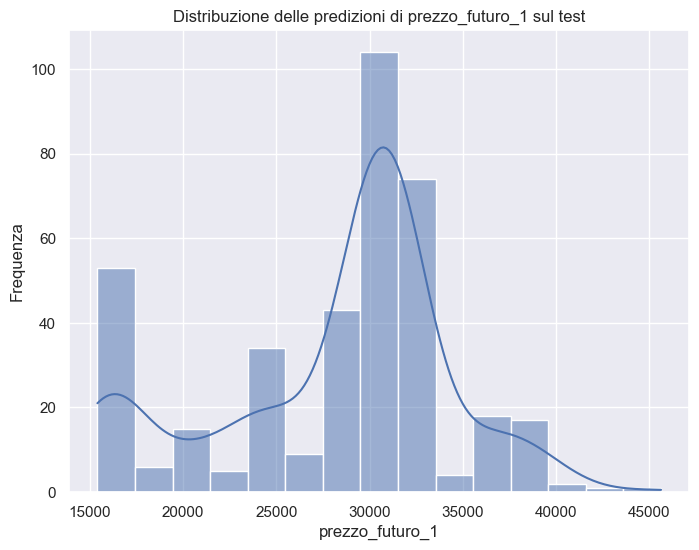

In [90]:
colonna_da_plottare = 'prezzo_futuro_1'

# Crea un istogramma utilizzando seaborn
plt.figure(figsize=(8, 6))
sns.histplot(predizioni_test, kde=True)  # kde=True aggiunge la stima della densità kernel
plt.title(f'Distribuzione delle predizioni di {colonna_da_plottare} sul test')
plt.xlabel(colonna_da_plottare)
plt.ylabel('Frequenza')
plt.show()

### Previsione dati inventati

In [437]:
X_res.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 113728 entries, 0 to 113727
Data columns (total 52 columns):
 #   Column                                              Non-Null Count   Dtype  
---  ------                                              --------------   -----  
 0   Eta_Debitore                                        113728 non-null  float64
 1   RATIO_ONERI_AFF_TOT_AFF                             113728 non-null  float64
 2   Cash Balance                                        113728 non-null  float64
 3   DurataFinanziamentoAnni                             113728 non-null  float64
 4   IMP_FINANZIATO                                      113728 non-null  float64
 5   AgeingErogazioneGg                                  113728 non-null  float64
 6   TOT_AFF                                             113728 non-null  float64
 7   Ratio_Rate_Imp1                                     113728 non-null  float64
 8   DistanzaAffidoUltimoPagamento                       113728 non-n

In [438]:
X_res.iloc[0:1]

,Eta_Debitore,RATIO_ONERI_AFF_TOT_AFF,Cash Balance,DurataFinanziamentoAnni,IMP_FINANZIATO,AgeingErogazioneGg,TOT_AFF,Ratio_Rate_Imp1,DistanzaAffidoUltimoPagamento,AgeingGestioneGg,Sesso_Non Valutabile,Sesso_Uomo,Nazionalita_Italiano,Nazionalita_Non Valutabile,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Metodo_pagamento_RI,NOSTART12M_SI,NOSTART6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,MACROAREA_Non Valutabile,MACROAREA_Nord_Est,MACROAREA_Nord_Ovest,MACROAREA_Sud_e_Isole
0,43.00,0.09,"3,413.69",5.00,"5,577.00",822.00,131.25,0.45,1.00,15.00,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0


In [ ]:
# dati_inventati = pd.DataFrame({'TOT_AFF': 204.82, 'TOT_ONERI_AFF': 18.62, 'Eta_Debitore':49.894593, 'AgeingErogazioneGg': 1898, 'IMP_FINANZIATO': 16201, 'AgeingGestioneGg': 14}, index=[0])
# modello_scelto.predict_proba(dati_inventati)[0][0]

### Scopro nuove cose

In [439]:
path = modello_scelto.estimators_[0].cost_complexity_pruning_path(X_res, y_res)
ccp_alphas, impurities = path.ccp_alphas, path.impurities

In [440]:
ccp_alphas

array([0.00000000e+00, 0.00000000e+00, 2.18745953e-07, 3.12636779e-07,
       3.54158851e-07, 4.37460102e-07, 8.43931266e-07, 1.24525861e-06,
       1.29986581e-06, 1.30265324e-06, 1.36080741e-06, 1.36938753e-06,
       1.39652090e-06, 1.58103275e-06, 1.58248392e-06, 1.75492578e-06,
       1.75858188e-06, 1.77023794e-06, 2.13161440e-06, 2.63787282e-06,
       2.63787282e-06, 2.75855981e-06, 2.78577817e-06, 2.82629231e-06,
       2.90654505e-06, 2.93096980e-06, 2.93096980e-06, 2.93096980e-06,
       3.10287419e-06, 3.13216810e-06, 3.22406678e-06, 3.44070368e-06,
       3.46233827e-06, 3.51716376e-06, 3.66371225e-06, 3.66371225e-06,
       3.66908704e-06, 3.71905047e-06, 3.74005598e-06, 3.81026074e-06,
       3.90989054e-06, 4.01961572e-06, 4.12167628e-06, 4.19661585e-06,
       4.35204607e-06, 4.44086333e-06, 4.50918431e-06, 4.54370438e-06,
       4.68955168e-06, 4.68955168e-06, 5.18178316e-06, 5.23387464e-06,
       5.27130029e-06, 5.47114363e-06, 5.82588013e-06, 5.86193960e-06,
      

Text(0.5, 1.0, 'Total Impurity vs effective alpha for training set')

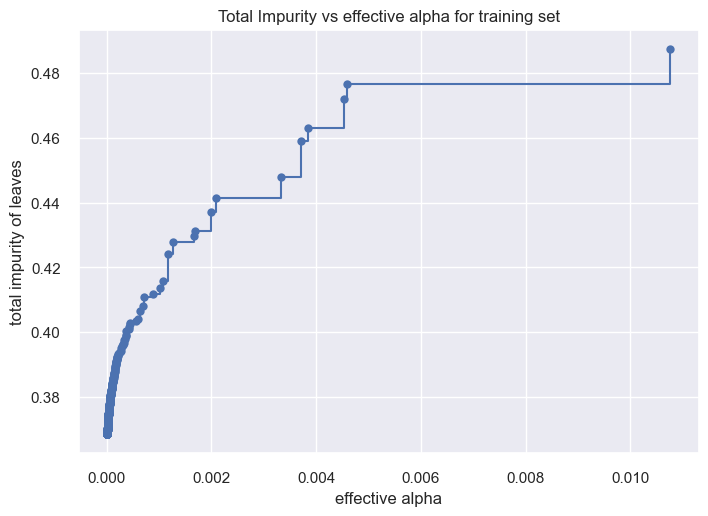

In [441]:
fig, ax = plt.subplots()
ax.plot(ccp_alphas[:-1], impurities[:-1], marker="o", drawstyle="steps-post")
ax.set_xlabel("effective alpha")
ax.set_ylabel("total impurity of leaves")
ax.set_title("Total Impurity vs effective alpha for training set")